# **Full-scaled sensitivity analysis: ResNet18**

## **Navigation**

- [**Basic imports and initialization**](#Basic-imports-and-initialization)
- [**1. Contrasting statistics**](#1.-Contrasting-statistics)
- [**2. Sampling scheme 1: Summary statistics**](#2.-Sampling-scheme-1:-Summary-statistics)
- [**3. Sampling scheme 1: Sobol indices**](#3.-Sampling-scheme-1:-Sobol-indices)
- [**4. Sampling scheme 2: Summary statistics**](#4.-Sampling-scheme-2:-Summary-statistics)
- [**5. Sampling scheme 2: Shapley values**](#5.-Sampling-scheme-2:-Shapley-values)

## Basic imports and initialization

$\qquad $ [[Back to top]](#Navigation) $\qquad$ [[Next part $\to$]](#1.-Sampling-scheme-1:-Summary-statistics)

- [Setting up templates, limiting the hardware resources, importing packages](#Setting-up-templates,-limiting-the-hardware-resources,-importing-packages)
- [Initializing common variables](#Initializing-common-variables)



### Setting up templates, limiting the hardware resources, importing packages

$\quad$[[Back to section]](#Basic-imports-and-initialization)$\quad$[[Next subsect.$\to$]](#Initializing-common-variables)

In [1]:
sh_file_type = 'base'
libstdcpp_path = ''

In the case of problems with loading ```libstc++.so.6```, please provide the path to the library. In any other case, just ignore the following block.

In [2]:
# in the case of problems with loading libstc++.so.6 provide the path to it
import ctypes

if sh_file_type == 'base':
    libstdcpp_path = '/mnt/bulky/pkharyuk/apd/envs/activation_sense/lib/libstdc++.so.6'
else:
    raise ValueError

try:
    _stdcxx_lib = ctypes.cdll.LoadLibrary(libstdcpp_path)
except:
    pass

To provide easy access to modules stored in the ```../src/``` directory, we use the following workaround:

In [3]:
import sys
sys.path.append('../src/')

Next, we limit the hardware usage by setting the configuration dictionaries, maximum number of threads:

In [4]:
# set limitations on hardware
import hardware_setup
hardware_setup.mkl_set_num_threads(num_threads=4)


# note about device: concerns only the inference of network
# all other operations including batch preprocessing will be performed
# on cpu only.

device = 'cpu' # 'cuda:0'
#device = 'cuda' if torch.cuda.is_available() else 'cpu'

if sh_file_type == 'base':
    mkl_num_threads = 5
    n_computing_processes = 4
else:
    raise ValueError

[mkl]: set up num_threads=4/4


Then we import all necessary packages:

In [5]:
import os
import copy

import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

import sensitivity_analysis.augmentation_setting
import sensitivity_analysis.visualize
import sensitivity_analysis.preprocess_visualize

import exp_assistance

### Initializing common variables

[[$\leftarrow$Prev.subsect.]](#Setting-up-templates,-limiting-the-hardware-resources,-importing-packages)$\quad$[[Back to section]](#Basic-imports-and-initialization)$\quad$

In [6]:
data_dirname = '../data/imagenet'
activations_dirname = '../results/'
model_dirname = '../torch-models/'
exp_relative_path = '../experiments/'

network_name = 'resnet18'
selected_network_modules = [
    'maxpool', # conv2d -> BN -> ReLU -> MaxPool2d
    'layer1', # Basic ResNet Block 1
    'layer2', # Basic ResNet Block 2
    'layer3', # Basic ResNet Block 3
    'avgpool', # Basic ResNet Block 1 -> AvgPool
    'fc'
]
network_modules = exp_assistance.convert_list2argstr(
    selected_network_modules
)
network_module_names = selected_network_modules# + ['model_outputs']
classification_layer_name = 'fc'

desired_image_height = 224
desired_image_width = 224

In [7]:
basic_config_dict = {
    'batch_size_activations_computing': 500,
    # 1000 classes; minimal number of samples/per class: 732
    'samples_per_class_train': 732, #
    'samples_per_class_valid': 50, #
    'data_dirname': data_dirname, #
    'activations_dirname': activations_dirname, #
    'model_dirname': model_dirname, #
    'mkl_num_threads': mkl_num_threads, #
    'device': device, #
    'recompute_activations': 1,
    'remove_activations_hdf5': 0, #
    'desired_image_height': desired_image_height, #
    'desired_image_width': desired_image_width, #
    'network_name': network_name, #
    'network_modules': network_modules,
    'classification_layer_name': classification_layer_name
}

if len(libstdcpp_path) > 0:
    basic_config_dict['libstdcpp_path'] = libstdcpp_path, #

## 1. Contrasting statistics

$\qquad\qquad\qquad\,\,\,\,$ [[Back to top]](#Navigation) $\qquad$ [[Next part $\to$]](#2.-Sampling-scheme-1:-Summary-statistics)

- [1.1 Configuring experiments and generating corresponding sh-files](#1.1-Configuring-experiments-and-generating-corresponding-sh-files)
- [1.2 Evaluating variables needed to plot the results](#1.2-Evaluating-variables-needed-to-plot-the-results)
- [1.3 Contrasting statistics: p-values](#1.3-Contrasting-statistics:-p-values)
- [1.4 Contrasting statistics: rank biserial correlation coefficients (effect size)](#1.4-Contrasting-statistics:-rank-biserial-correlation-coefficients-(effect-size))
- [1.5 RBSCC masked by p-values greater than or equal to specified alpha](#1.5-RBSCC-masked-by-p-values-greater-than-or-equal-to-specified-alpha)
    - [1.5.1 Train. part](#1.5.1-Train.-part)
    - [1.5.2 Valid. part](#1.5.2-Valid.-part)

### 1.1 Configuring experiments and generating corresponding sh-files

$\qquad\qquad$$\quad$[[Back to section]](#1.-Contrasting-statistics)$\quad$[[Next subsect.$\to$]](#1.2-Evaluating-variables-needed-to-plot-the-results)


```Config_dict``` accumulates all necessary parameters.

In [8]:
config_dict_exp_1_1 = copy.deepcopy(basic_config_dict)

config_dict_exp_1_1['values_buffer_size'] = 1000
config_dict_exp_1_1['torch_seed'] = 178
config_dict_exp_1_1['numpy_seed'] = 157
config_dict_exp_1_1['class_sampler_seed'] = 322
config_dict_exp_1_1['class_selector_seed'] = 513
config_dict_exp_1_1['augpar_sampler_seeds'] = "188" # (0, 1, ..., n_augs-1)
config_dict_exp_1_1['subset_random_state_train'] = 537
config_dict_exp_1_1['subset_random_state_valid'] = 557
config_dict_exp_1_1['Nsamples'] = 45000#50*1000#10*1000
config_dict_exp_1_1['Ninner_samples'] = 10
config_dict_exp_1_1['Njobs_cs_computing'] = n_computing_processes
config_dict_exp_1_1['augmentation_set_number'] = 3 # separate files
config_dict_exp_1_1['activations_fnm_prefix'] = f'cut_cs_{network_name}_imagenet_ILSVRC_activations'
config_dict_exp_1_1['values_fnm_prefix'] = f'cs_{network_name}_imagenet_ILSVRC_values'

In [170]:
####################################################################################
script_filename_base = 'script_exp1.1'
exp_filename = '1.1_imagenet_contrast.py'
exp_script_path = os.path.join(exp_relative_path, exp_filename)
for dataset_part in ['train', 'valid']:
    config_dict_exp_1_1['dataset_part'] = dataset_part
    current_script_filename = f'{script_filename_base}_part={dataset_part}.sh'
    
    exp_assistance.build_sh_exp_files(
        config_dict_exp_1_1,
        script_path=current_script_filename,
        experiment_file_path=exp_script_path,
        which=sh_file_type,
    );

### 1.2 Evaluating variables needed to plot the results

[[$\leftarrow$Prev.subsect.]](#1.1-Configuring-experiments-and-generating-corresponding-sh-files)$\quad$[[Back to section]](#1.-Contrasting-statistics)$\quad$[[Next subsect.$\to$]](#1.3-Contrasting-statistics:-p-values)

It is supposed that one has already run all necessary experiments and obtained the corresponding results.

In [9]:
augmentation_set_number = 3
alpha_fdr = 0.95

aug_names = sensitivity_analysis.augmentation_setting.get_augmentation_transforms_names(
    augmentation_set_number,
    use_permutation_variable=False,
    use_class_variable=False,
    use_partition_variable=False
)

aug_names = list(map(lambda x: x.replace('_transform', ''), aug_names))

cs_paths = {}
for dataset_part in ['train', 'valid']:
    fnm_suffix = (
        f'part={dataset_part}'
    )
    cs_paths[dataset_part] = {}
    for i_aug, aug_name in enumerate(aug_names):
        cs_fnm = f'{config_dict_exp_1_1["values_fnm_prefix"]}_{aug_name}_{fnm_suffix}.hdf5'
        cs_path = os.path.join(config_dict_exp_1_1["activations_dirname"], cs_fnm)
        # correct p-values for multiple hypothesis testing
        new_cs_path = sensitivity_analysis.utils.correct_pvalues_within_hdf5(
            cs_path,
            network_module_names,
            values_name='cs_pvals',
            alpha=alpha_fdr,
            method='fdr_by',
            suffix='fdr-by-corrected'
        )
        cs_paths[dataset_part][aug_name] = new_cs_path
    
vmin, vmax = 0, 1
n_col_blocks = 6 # 5 + 7 augmentaions, 6 per row
n_cols = 8 # min. number of channels = 64, others are divisable on it
n_rows_fc = 18

n_conv_modules = len(
    list(filter(lambda x: ('maxpool' in x) or ('layer' in x) or ('avgpool' in x), network_module_names))
)

In [10]:
local_params_dict_1 = {
    'network_module_names': network_module_names,
    'augmentations_list': aug_names,
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_col_blocks': n_col_blocks,
    'n_rows_fc': n_rows_fc,
    'vmin': vmin,
    'vmax': vmax,
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
}

### 1.3 Contrasting statistics: p-values

To reduce the size of the notebook, here we plot the train part only. One may easily produce plot for ```'valid'``` part by changing the ```'dataset_part'``` variable.

[[$\leftarrow$Prev.subsect.]](#1.2-Evaluating-variables-needed-to-plot-the-results)$\quad$[[Back to section]](#1.-Contrasting-statistics)$\quad$[[Next subsect.$\to$]](#1.4-Contrasting-statistics:-rank-biserial-correlation-coefficients-(effect-size))

maxpool


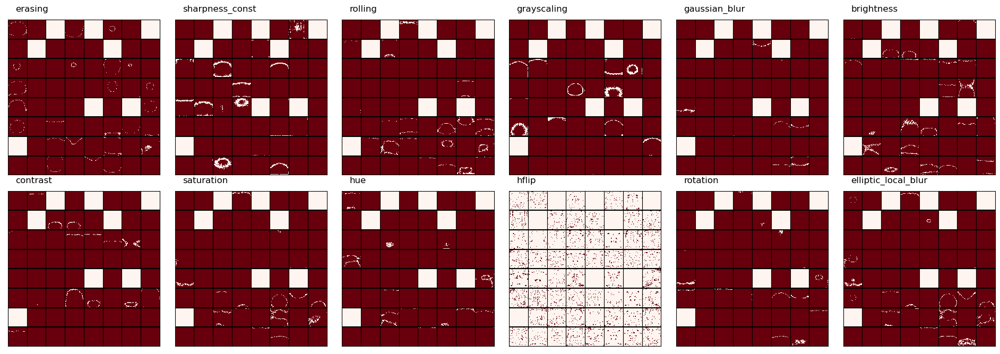

layer1


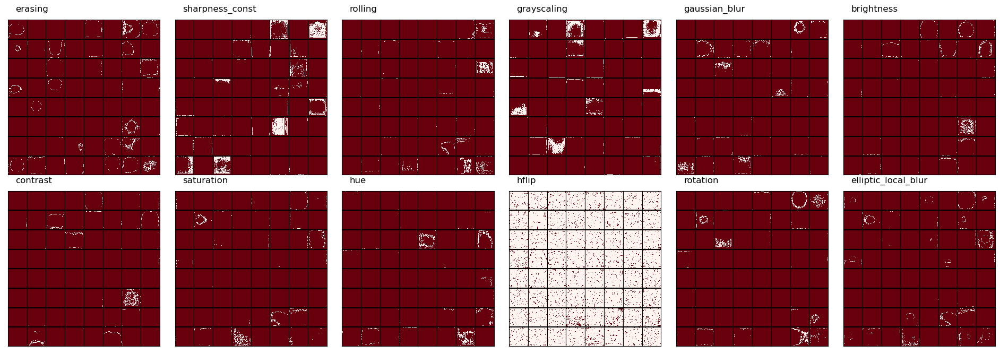

layer2


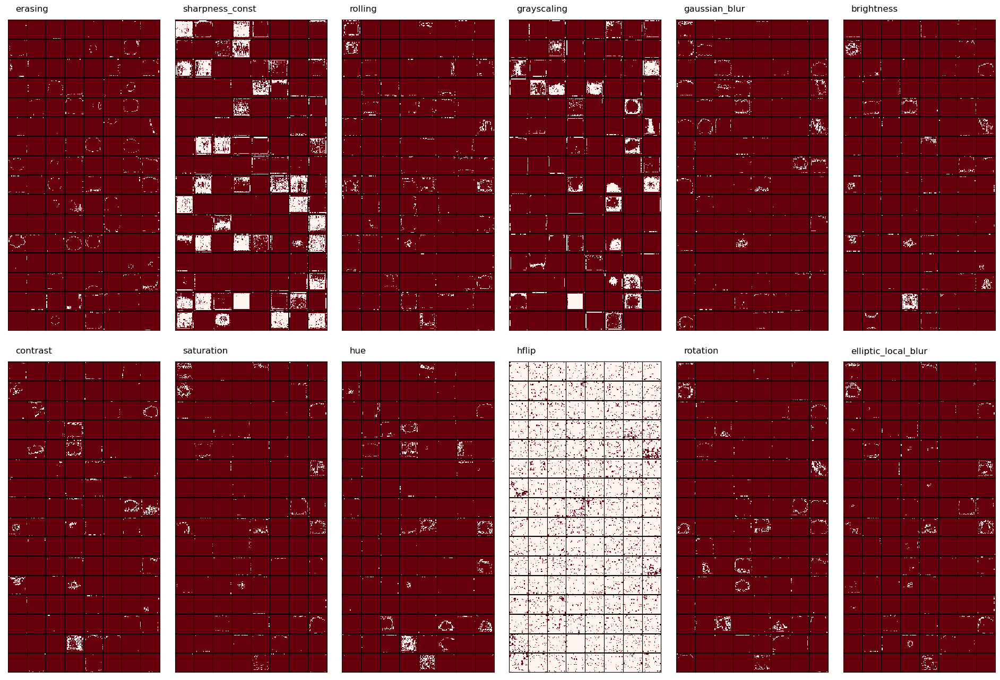

layer3


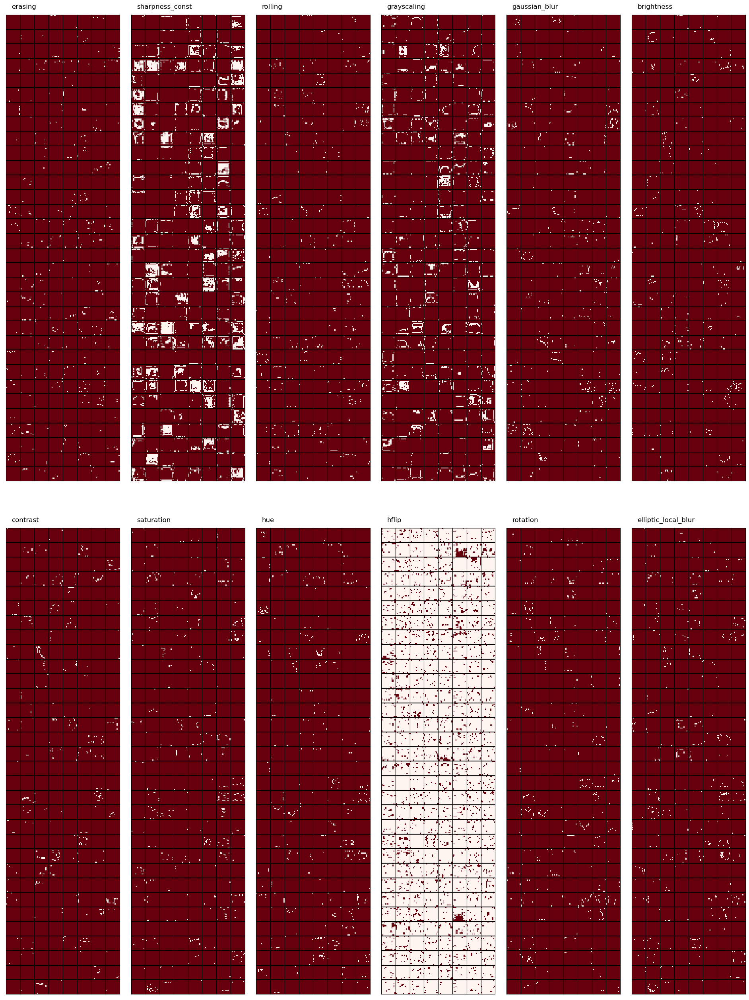

avgpool


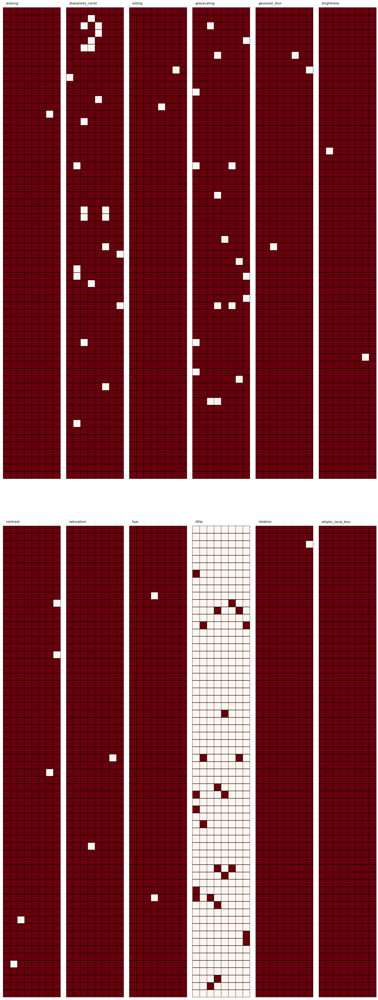

fc


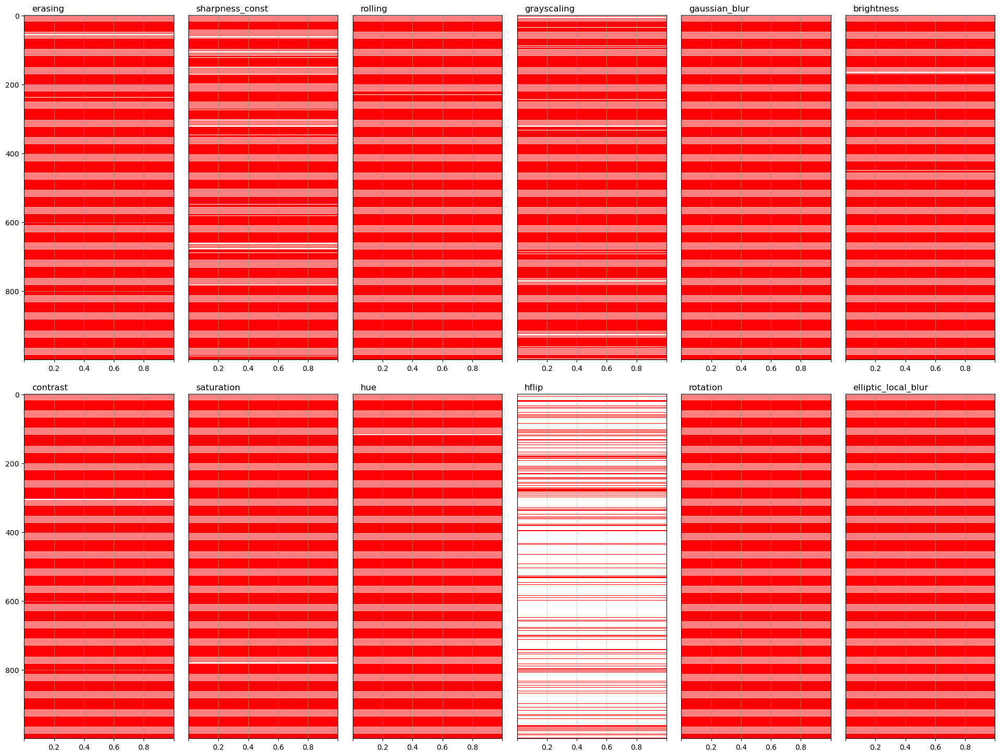

In [12]:
dataset_part = 'train'

sensitivity_analysis.visualize.cs_compact_plot_blocks(
    cs_paths_dict=cs_paths[dataset_part],
    values_name='cs_pvals',
    values_func=sensitivity_analysis.preprocess_visualize.threshold_pvalues,
    show_colorbar=False,
    **local_params_dict_1,
)

### 1.4 Contrasting statistics: rank biserial correlation coefficients (effect size)

[[$\leftarrow$Prev.subsect.]](#1.3-Contrasting-statistics:-p-values)$\quad$[[Back to section]](#1.-Contrasting-statistics)$\quad$[[Next subsect.$\to$]](#1.5-RBSCC-masked-by-p-values-greater-than-or-equal-to-specified-alpha)

maxpool


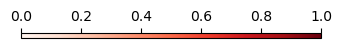

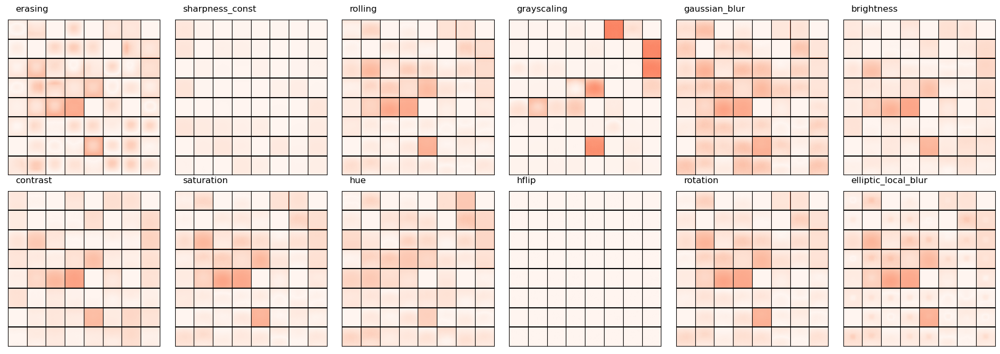

layer1


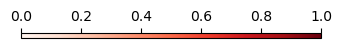

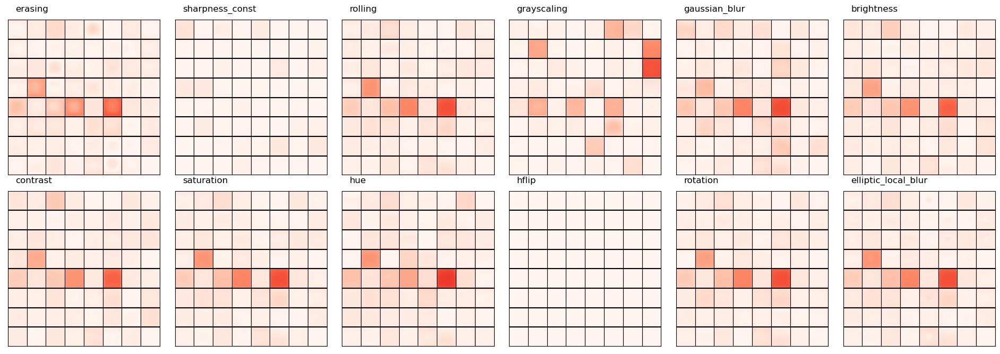

layer2


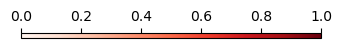

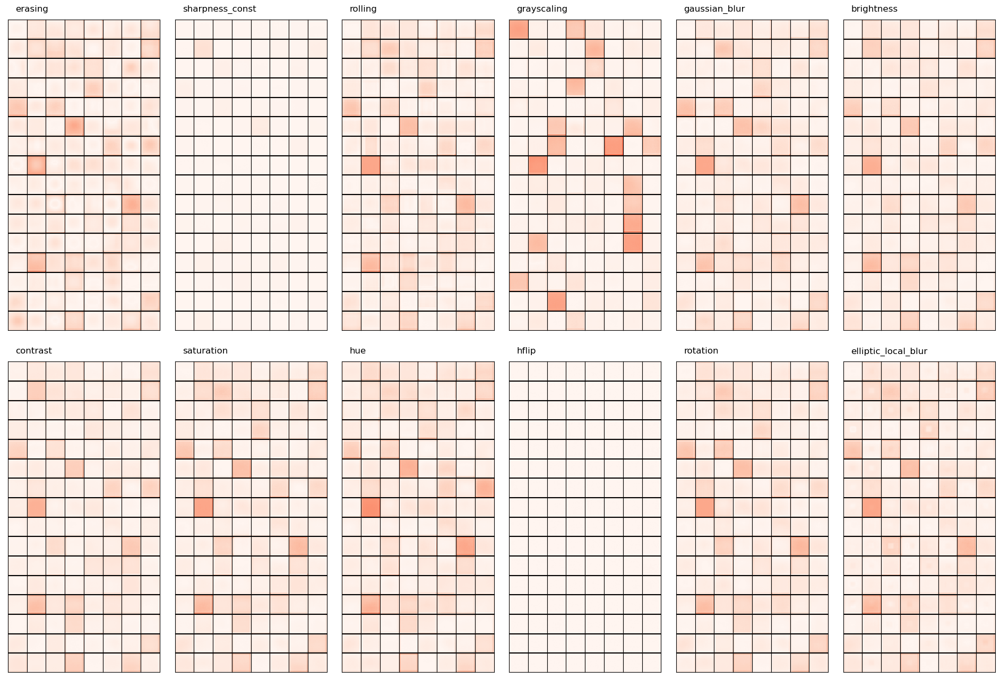

layer3


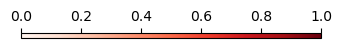

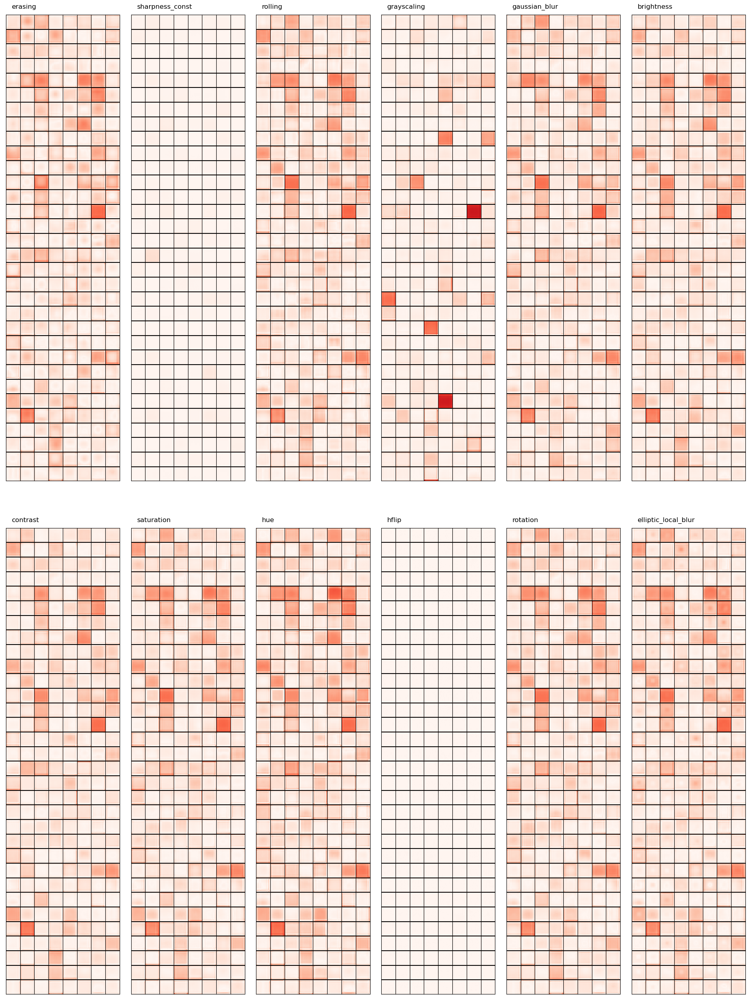

avgpool


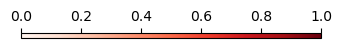

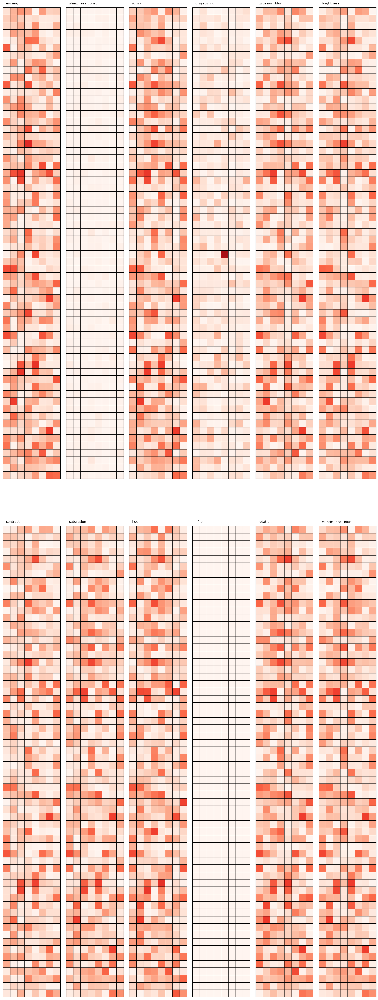

fc


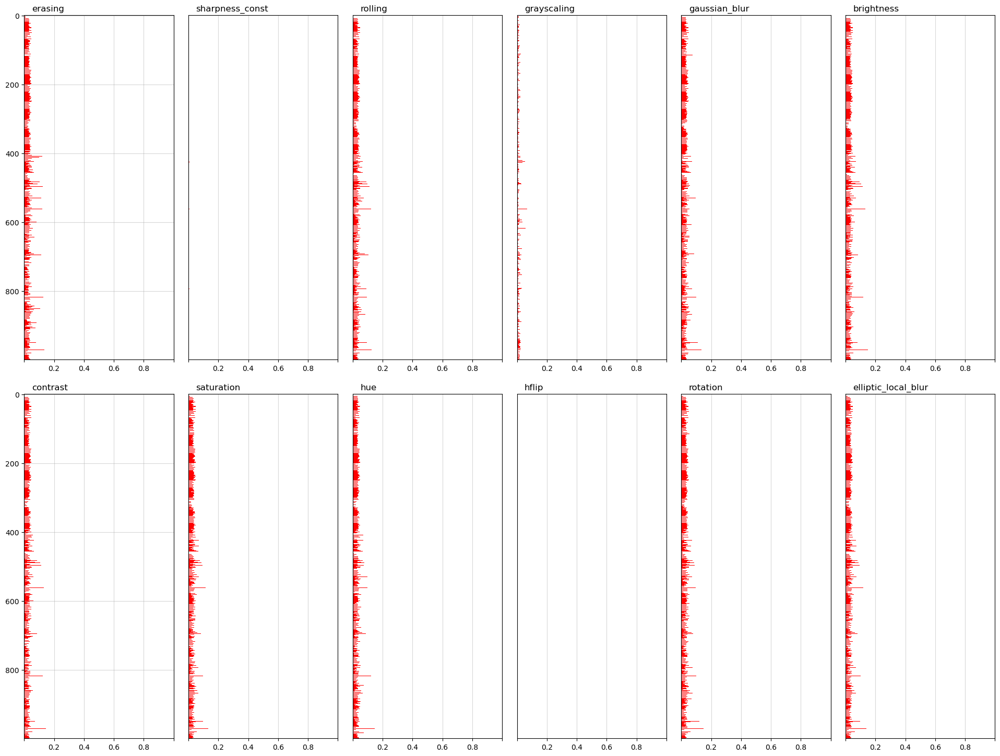

In [13]:
dataset_part = 'train'

sensitivity_analysis.visualize.cs_compact_plot_blocks(
    cs_paths_dict=cs_paths[dataset_part],
    values_name='cs_rbscc',
    values_func=np.abs,
    show_colorbar=True,
    **local_params_dict_1,
)

### 1.5 RBSCC masked by p-values greater than or equal to specified alpha

[[$\leftarrow$Prev.subsect.]](#1.4-Contrasting-statistics:-rank-biserial-correlation-coefficients-(effect-size))$\quad$[[Back to section]](#1.-Contrasting-statistics)

- [1.5.1 Train. part](#1.5.1-Train.-part)
- [1.5.2 Valid. part](#1.5.2-Valid.-part)

#### 1.5.1 Train. part

[[Back to subsection]](#1.5-RBSCC-masked-by-p-values-greater-than-or-equal-to-specified-alpha)

maxpool


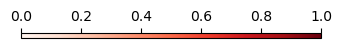

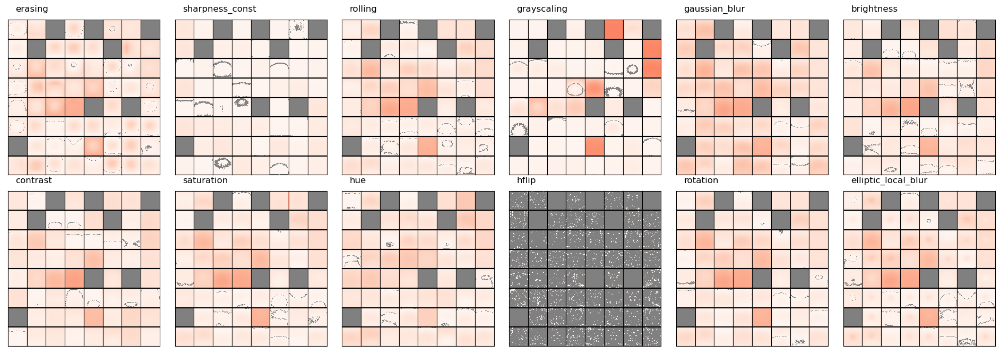

layer1


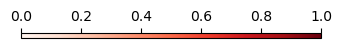

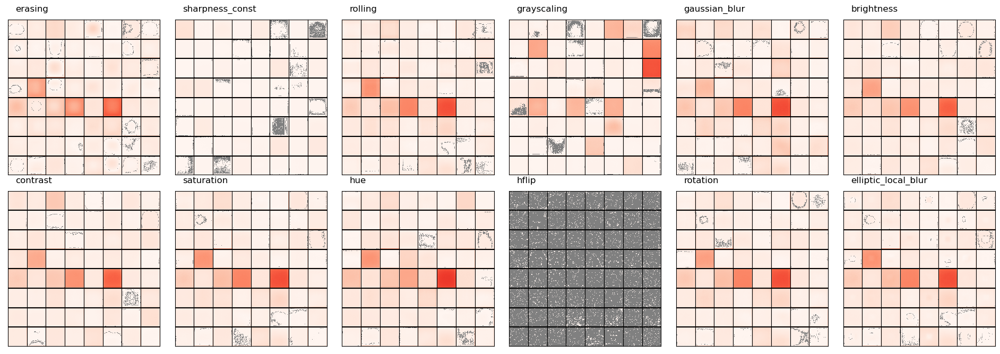

layer2


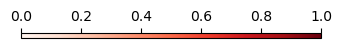

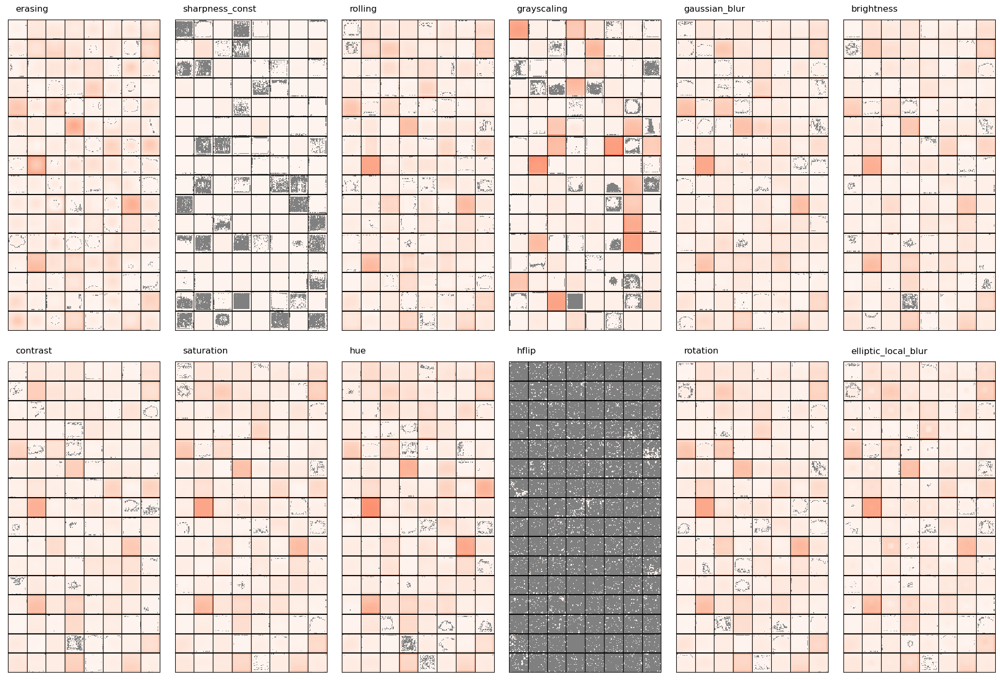

layer3


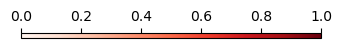

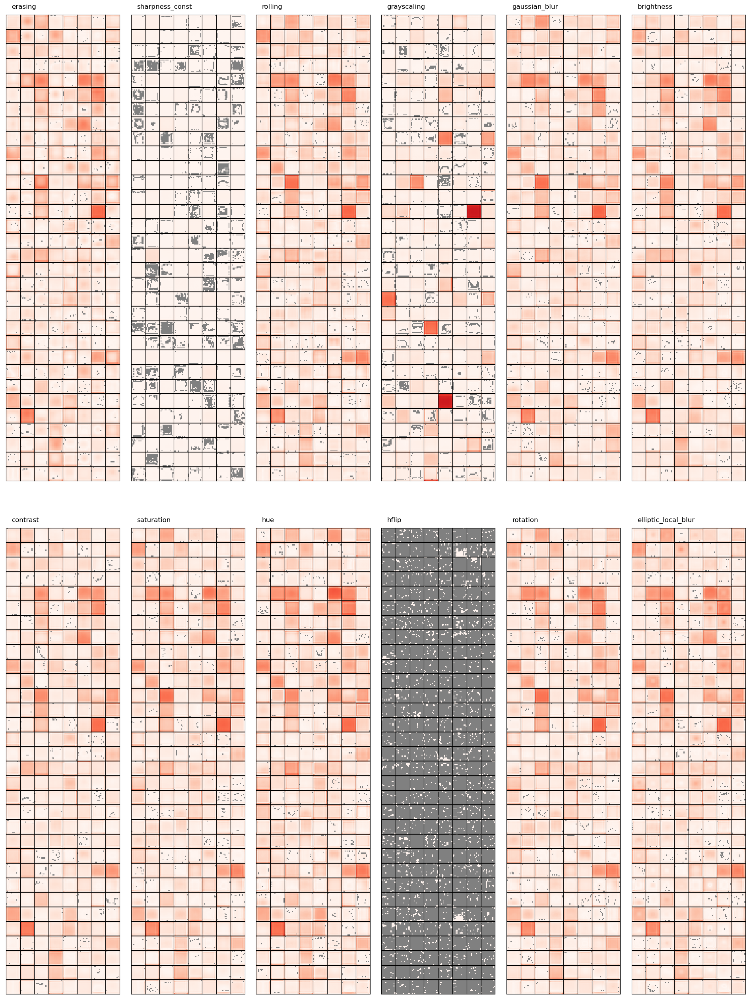

avgpool


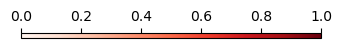

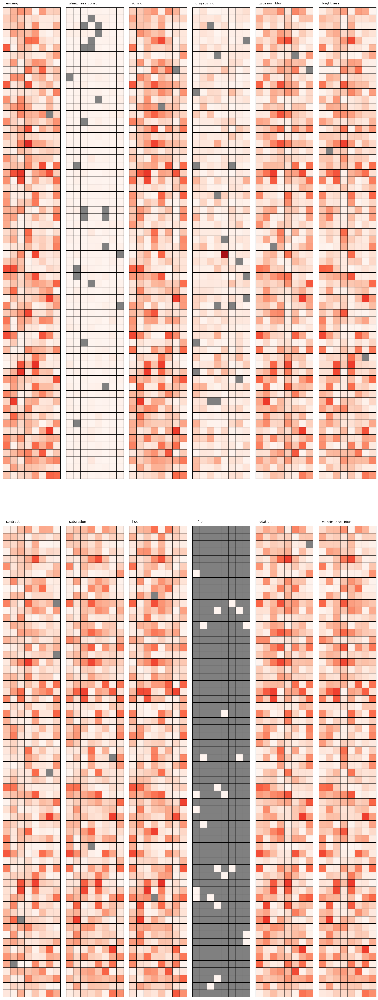

fc


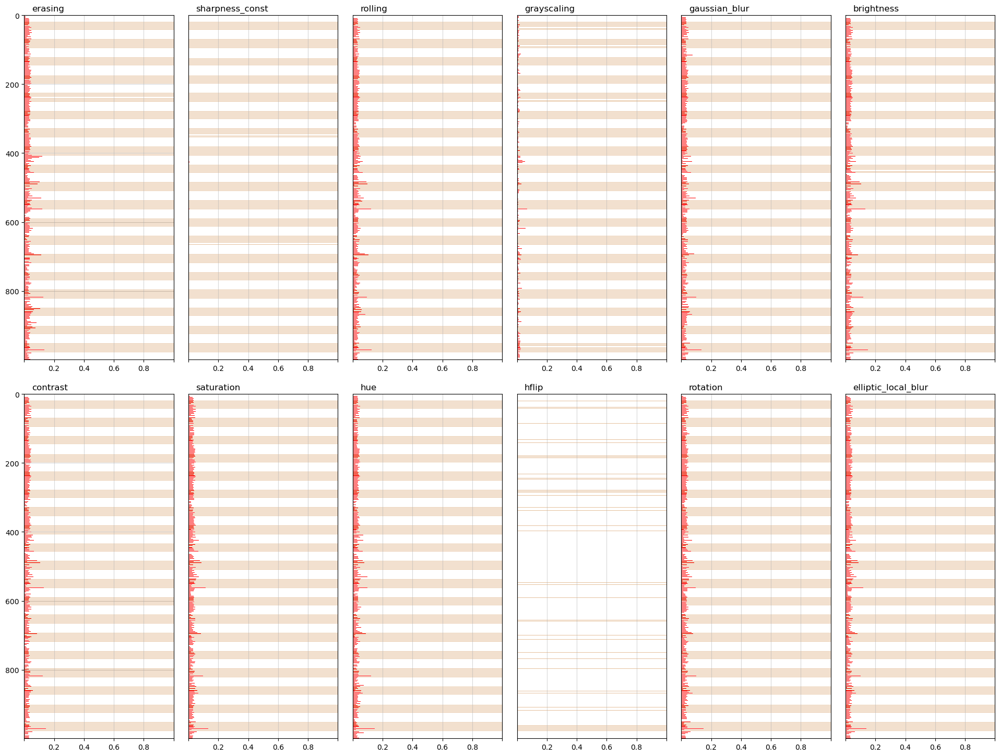

In [14]:
dataset_part = 'train'

sensitivity_analysis.visualize.cs_compact_plot_blocks(
    cs_paths_dict=cs_paths[dataset_part],    
    values_name='cs_rbscc',
    values_func=np.abs,
    masks_paths_dict=cs_paths[dataset_part],
    masking_func=sensitivity_analysis.preprocess_visualize.threshold_pvalues,
    masking_values_name='cs_pvals',
    mask_color_name='peru',#'firebrick'
    show_colorbar=True,
    **local_params_dict_1,
)

#### 1.5.2 Valid. part

[[Back to subsection]](#1.5-RBSCC-masked-by-p-values-greater-than-or-equal-to-specified-alpha)

maxpool


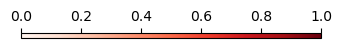

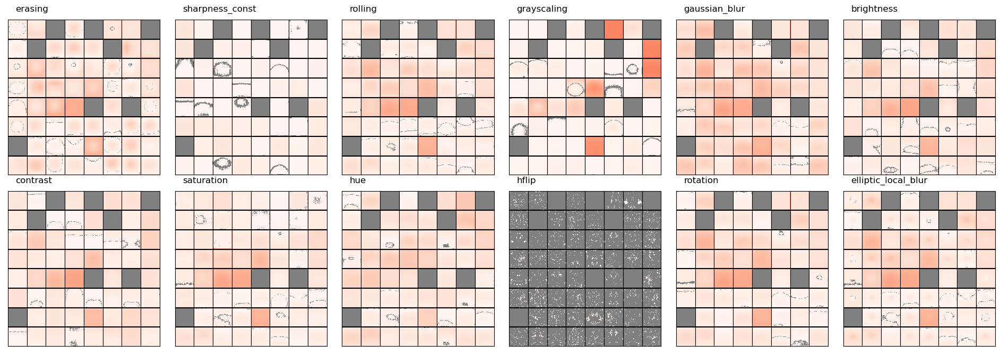

layer1


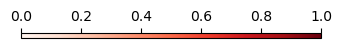

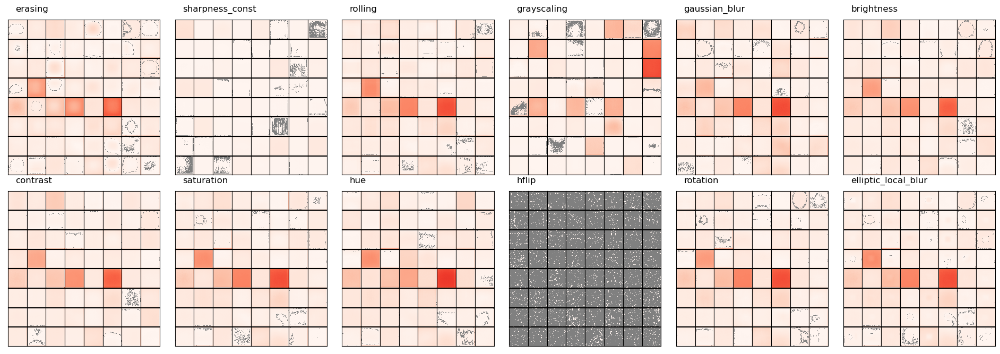

layer2


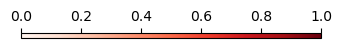

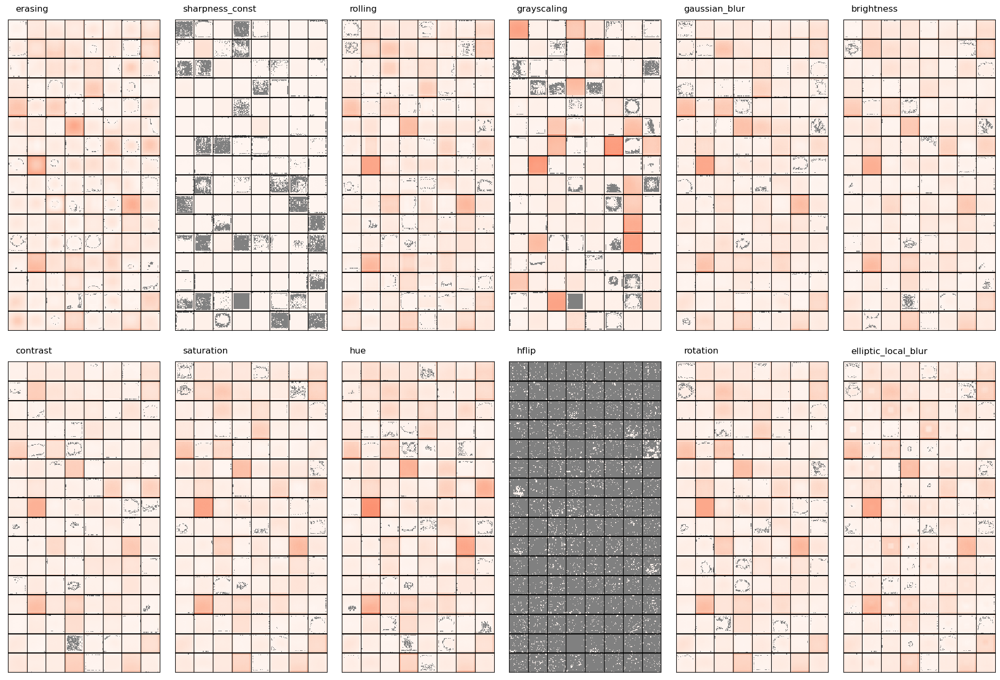

layer3


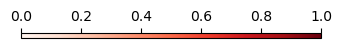

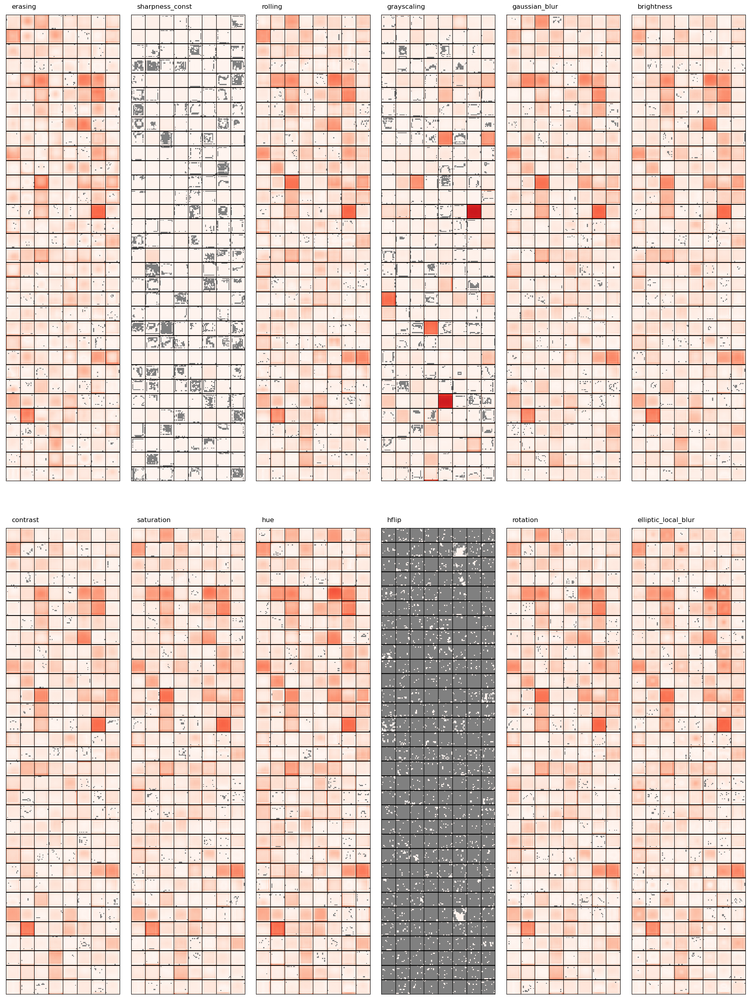

avgpool


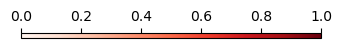

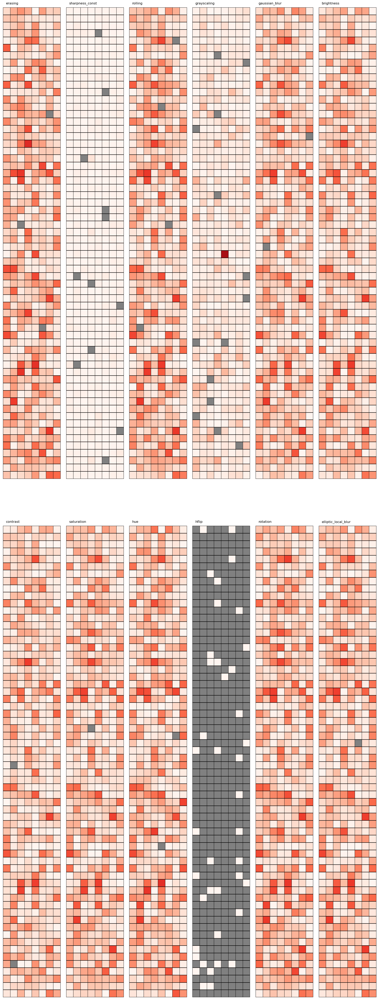

fc


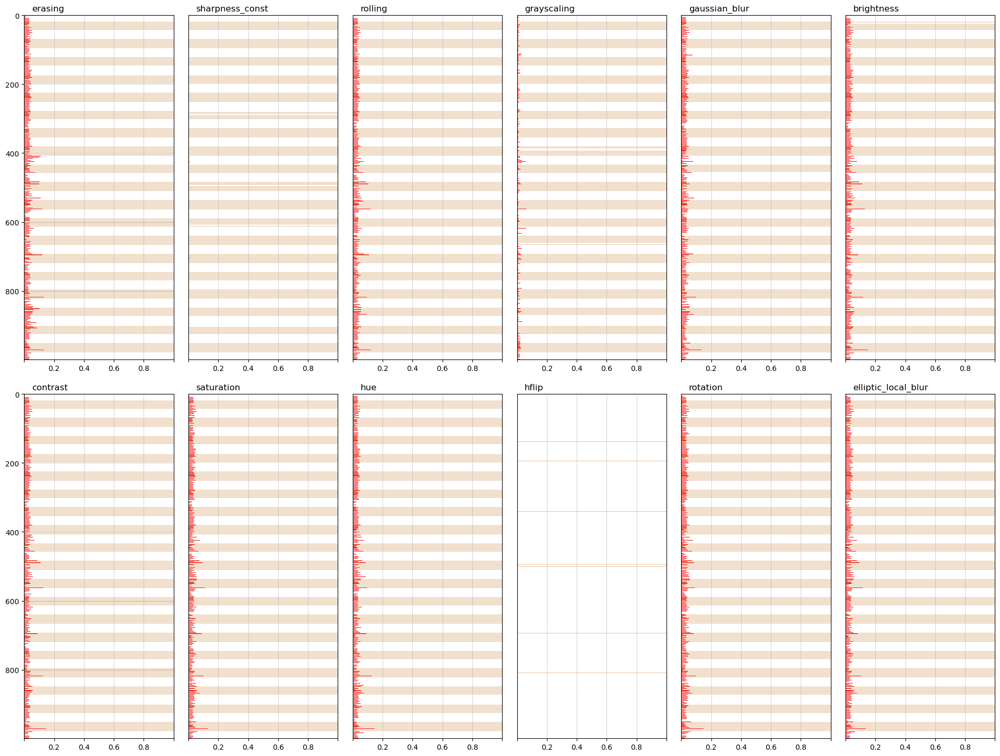

In [15]:
dataset_part = 'valid'

sensitivity_analysis.visualize.cs_compact_plot_blocks(
    cs_paths_dict=cs_paths[dataset_part],
    values_name='cs_rbscc',
    values_func=np.abs,
    masks_paths_dict=cs_paths[dataset_part],
    masking_func=sensitivity_analysis.preprocess_visualize.threshold_pvalues,
    masking_values_name='cs_pvals',
    mask_color_name='peru',#'firebrick'
    show_colorbar=True,
    **local_params_dict_1,
)

## 2. Sampling scheme 1: Summary statistics

[[$\leftarrow$ Prev.part]](#1.-Contrasting-statistics) $\qquad$ [[Back to top]](#Navigation) $\qquad$ [[Next part $\to$]](#3.-Sampling-scheme-1:-Sobol-indices)

- [2.1 Configuring experiments and generating corresponding sh files](#2.1-Configuring-experiments-and-generating-corresponding-sh-files)
- [2.2 Evaluating variables needed to plot the results](#2.2-Evaluating-variables-needed-to-plot-the-results)
- [2.3 Log-transformed (modules of) mean values](#2.3-Log-transformed-(modules-of)-mean-values)
    - [2.3.1 Augmentation set #1](#2.3.1-Augmentation-set-#1)
    - [2.3.2 Augmentation set #2](#2.3.2-Augmentation-set-#2)
- [2.4 Log-transformed total variances](#2.4-Log-transformed-total-variances)
    - [2.4.1 Augmentation set #1](#2.4.1-Augmentation-set-#1)
    - [2.4.2 Augmentation set #2](#2.4.2-Augmentation-set-#2)
- [2.5 Coefficients of Variance](#2.5-Coefficients-of-Variance)
    - [2.5.1 Augmentation set #1](#2.5.1-Augmentation-set-#1)
    - [2.5.2 Augmentation set #2](#2.5.2-Augmentation-set-#2)


### 2.1 Configuring experiments and generating corresponding sh-files

$\quad$[[Back to section]](#2.-Sampling-scheme-1:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#2.2-Evaluating-variables-needed-to-plot-the-results)

```Config_dict``` accumulates all necessary parameters.

In [17]:
config_dict_exp_1_2 = copy.deepcopy(basic_config_dict)

config_dict_exp_1_2['buffer_size_tv_computing'] = 1000
config_dict_exp_1_2['subset_random_state_train'] = 536
config_dict_exp_1_2['subset_random_state_valid'] = 555
config_dict_exp_1_2['torch_seed'] = 917
config_dict_exp_1_2['numpy_seed'] = 615
config_dict_exp_1_2['class_sampler_seed'] = 532
config_dict_exp_1_2['dataset_part'] = 'train+valid'
config_dict_exp_1_2['Njobs_tv_computing'] = n_computing_processes
config_dict_exp_1_2['augset1_p'] = 0.5
config_dict_exp_1_2['augset2_p'] = 0.5
config_dict_exp_1_2['activations_fnm_prefix'] = f'sitv_{network_name}_imagenet_ILSVRC_activations'
config_dict_exp_1_2['values_fnm_prefix'] = f'sitv_{network_name}_imagenet_ILSVRC_values'
config_dict_exp_1_2['Nsamples'] = 2**16 # 14
config_dict_exp_1_2['compute_s2'] = 1
config_dict_exp_1_2['use_permutation_variable'] = 1
config_dict_exp_1_2['use_switch_variables'] = 0
config_dict_exp_1_2['use_partition_variable'] = 1

In [11]:
####################################################################################
script_filename_base = 'script_exp1.2'
exp_filename = '1.2_imagenet_si_variance.py'
exp_script_path = os.path.join(exp_relative_path, exp_filename)
for augmentation_set_number in [1, 2]:
    config_dict_exp_1_2['augmentation_set_number'] = augmentation_set_number
    current_script_filename = f'{script_filename_base}_aug={augmentation_set_number}.sh'
    
    exp_assistance.build_sh_exp_files(
        config_dict_exp_1_2,
        current_script_filename,
        exp_script_path,
        which=sh_file_type,
    );

### 2.2 Evaluating variables needed to plot the results

[[$\leftarrow$Prev.subsect.]](#2.1-Configuring-experiments-and-generating-corresponding-sh-files)$\quad$[[Back to section]](#2.-Sampling-scheme-1:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#2.3-Log-transformed-(modules-of)-mean-values)

It is supposed that one has already run all necessary experiments and obtained the corresponding results.

In [18]:
# plot the results
dataset_part = config_dict_exp_1_2['dataset_part']
use_switch_variables = False

sitv_results_path_dict = {}
for augmentation_set_number in [1, 2]:
    fnm_suffix = fnm_suffix = (
        f'part={dataset_part}'
        f'_augnm={augmentation_set_number}'
    )
    sitv_results_path = os.path.join(
        activations_dirname, f'{config_dict_exp_1_2["values_fnm_prefix"]}_{fnm_suffix}.hdf5'
    )
    sitv_results_path_dict[augmentation_set_number] = sitv_results_path

n_cols = 8 # min. number of channels = 64, others are divisable on it
n_conv_modules = len(
    list(filter(lambda x: ('maxpool' in x) or ('layer' in x) or ('avgpool' in x), network_module_names))
)

In [27]:
local_params_dict_2 = {
    'network_module_names': network_module_names,
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_col_blocks': n_conv_modules,
    'n_rows_fc': n_rows_fc,
    'vmin': 0,
    'vmax': None,
    #'save_path': None,
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
    'figsize': (15, 30),
    'rescale_conv_blocks': False,
    'fc_height_fraction': 0.1,
    #'show_colorbar': True,
    'global_colorbounds': True,
    'global_bounds_conv_only': True
}

### 2.3 Log-transformed (modules of) mean values

[[$\leftarrow$Prev.subsect.]](#2.2-Evaluating-variables-needed-to-plot-the-results)$\quad$[[Back to section]](#2.-Sampling-scheme-1:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#2.4-Log-transformed-total-variances)

- [2.3.1 Augmentation set #1](#2.3.1-Augmentation-set-#1)
- [2.3.2 Augmentation set #2](#2.3.2-Augmentation-set-#2)

#### 2.3.1 Augmentation set #1

[[Back to subsection]](#2.3-Log-transformed-(modules-of)-mean-values)

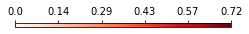

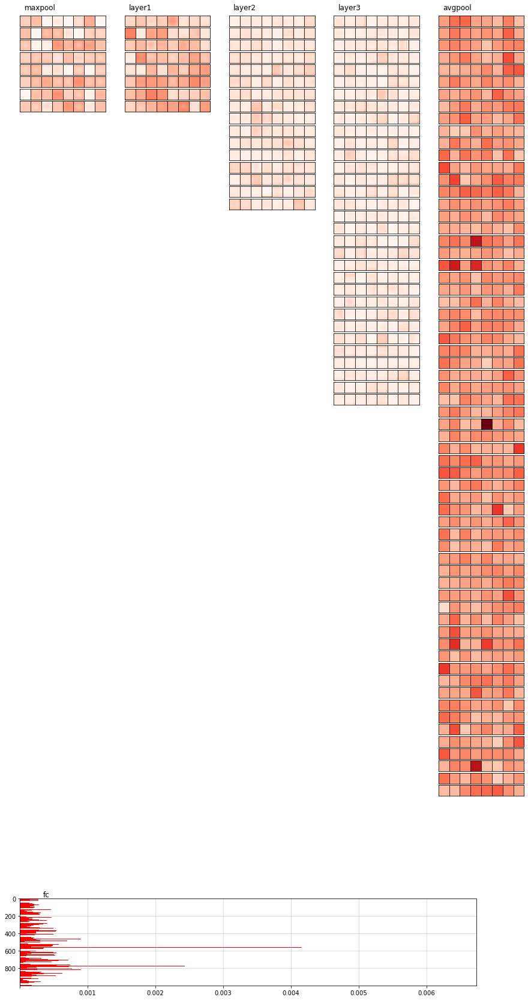

In [19]:
augmentation_set_number = 1

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name='mean',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_2,
)

#### 2.3.2 Augmentation set #2

[[Back to subsection]](#2.3-Log-transformed-(modules-of)-mean-values)

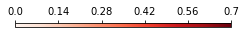

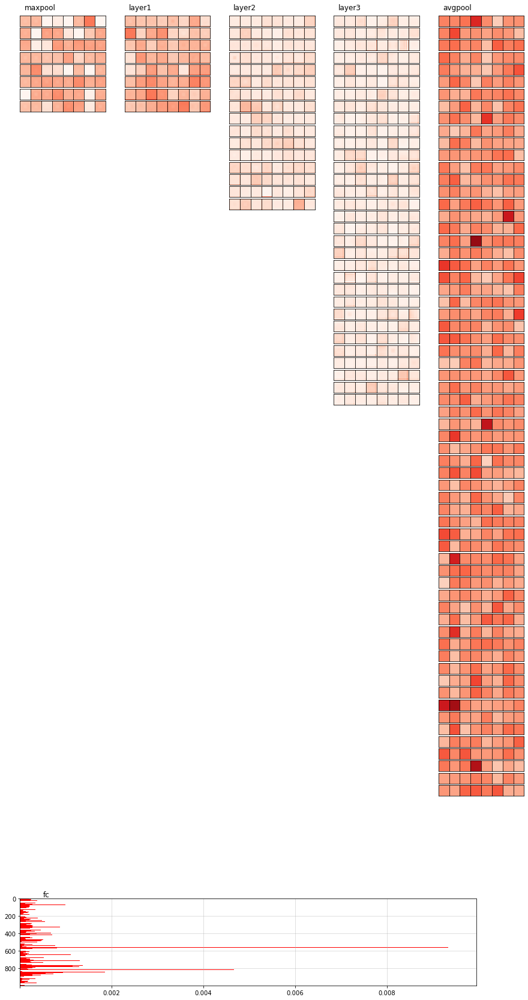

In [20]:
augmentation_set_number = 2

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name='mean',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_2,
)

### 2.4 Log-transformed total variances

[[$\leftarrow$Prev.subsect.]](#2.3-Log-transformed-(modules-of)-mean-values)$\quad$[[Back to section]](#2.-Sampling-scheme-1:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#2.5-Coefficients-of-Variance)

- [2.4.1 Augmentation set #1](#2.4.1-Augmentation-set-#1)
- [2.4.2 Augmentation set #2](#2.4.2-Augmentation-set-#2)

#### 2.4.1 Augmentation set #1

[[Back to subsection]](#2.4-Log-transformed-total-variances)

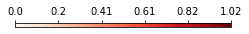

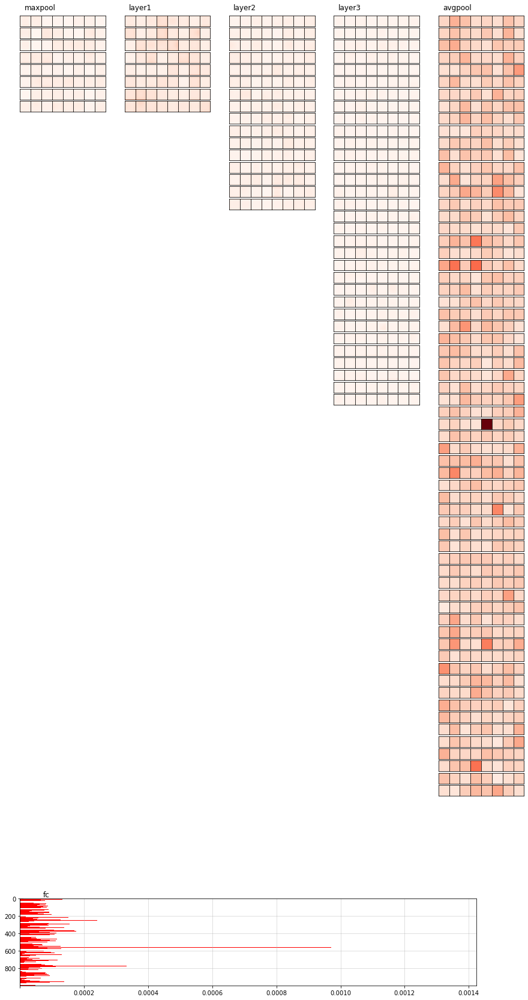

In [31]:
augmentation_set_number = 1

save_dirname = '../results/resnet18/cov_si/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_si_siT_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_si_siT_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name='var',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_2,
)

#### 2.4.2 Augmentation set #2

[[Back to subsection]](#2.4-Log-transformed-total-variances)

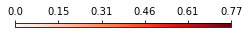

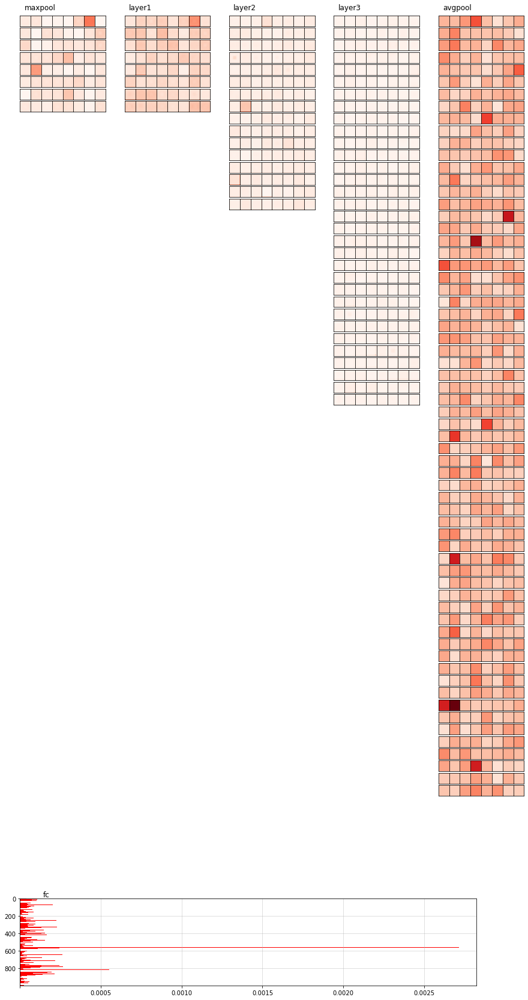

In [32]:
augmentation_set_number = 2

save_dirname = '../results/resnet18/cov_si/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_si_siT_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_si_siT_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name='var',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_2,
)

### 2.5 Coefficients of Variance

[[$\leftarrow$Prev.subsect.]](#2.4-Log-transformed-total-variances)$\quad$[[Back to section]](#2.-Sampling-scheme-1:-Summary-statistics)

- [2.5.1 Augmentation set #1](#2.5.1-Augmentation-set-#1)
- [2.5.2 Augmentation set #2](#2.5.2-Augmentation-set-#2)

#### 2.5.1 Augmentation set #1

[[Back to subsection]](#2.5-Coefficients-of-Variance)

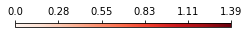

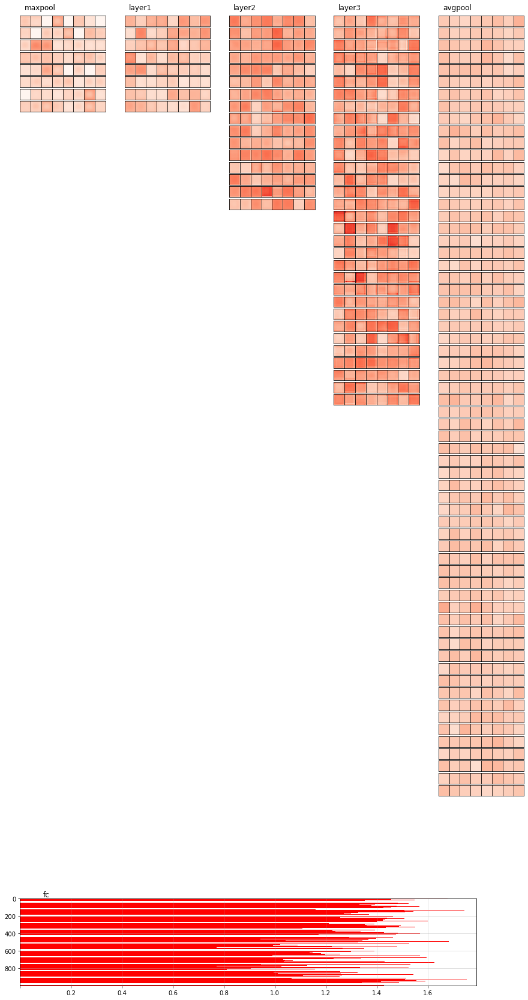

In [33]:
augmentation_set_number = 1

save_dirname = '../results/resnet18/cvs_si/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_si_siT_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_si_siT_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name=('var', 'mean'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_coef_var,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_2,
)

#### 2.5.2 Augmentation set #2

[[Back to subsection]](#2.5-Coefficients-of-Variance)

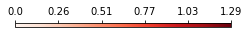

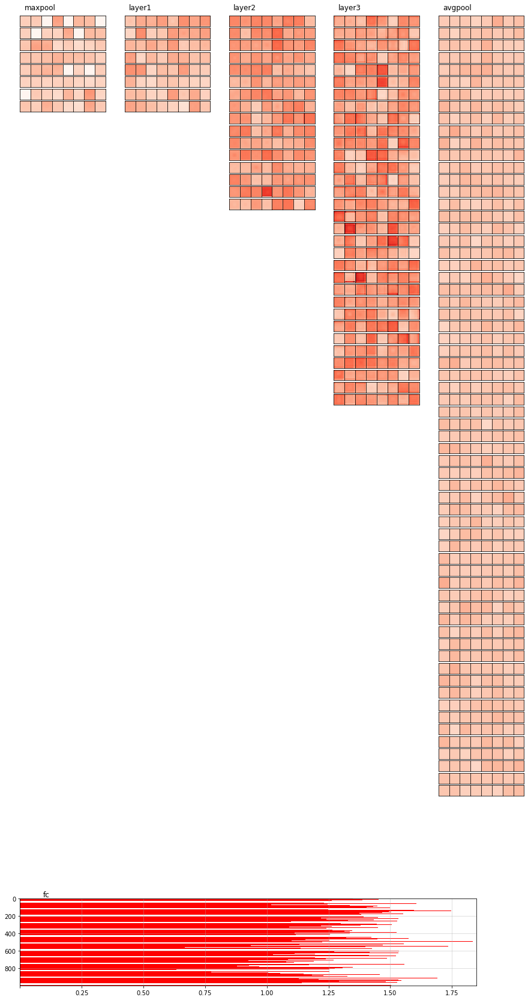

In [34]:
augmentation_set_number = 2

save_dirname = '../results/resnet18/cvs_si/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_si_siT_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_si_siT_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=sitv_results_path_dict[augmentation_set_number],
    values_name=('var', 'mean'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_coef_var,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_2,
)

## 3. Sampling scheme 1: Sobol indices

[[$\leftarrow$ Prev.part]](#2.-Sampling-scheme-1:-Summary-statistics) $\qquad$ [[Back to top]](#Navigation) $\qquad$ [[Next part $\to$]](#4.-Sampling-scheme-2:-Summary-statistics)


- [3.1-Configuring-experiments-and-generating-corresponding-sh-files](#3.1-Configuring-experiments-and-generating-corresponding-sh-files)
- [3.2-Evaluating-variables-needed-to-plot-the-results](#3.2-Evaluating-variables-needed-to-plot-the-results)
- [3.3-Layer-wise-histograms-of-computed-Sobol-indices](#3.3-Layer-wise-histograms-of-computed-Sobol-indices)
    - [3.3.1 Augmentation set #1](#3.3.1-Augmentation-set-#1)
    - [3.3.2 Augmentation set #2](#3.3.2-Augmentation-set-#2)
- [3.4-Sobol-indices:-1st-order-and-total](#3.4-Sobol-indices:-1st-order-and-total)
    - [3.4.1 Augmentation set #1](#3.4.1-Augmentation-set-#1)
    - [3.4.2 Augmentation set #2](#3.4.2-Augmentation-set-#2)
- [3.5-Sobol-indices:-2nd-order](#3.5-Sobol-indices:-2nd-order)
    - [3.5.1 Augmentation set #1](#3.5.1-Augmentation-set-#1)
    - [3.5.2 Augmentation set #2](#3.5.2-Augmentation-set-#2)


### 3.1 Configuring experiments and generating corresponding sh-files

$\quad$[[Back to section]](#3.-Sampling-scheme-1:-Sobol-indices)$\quad$[[Next subsect.$\to$]](#3.2-Evaluating-variables-needed-to-plot-the-results)

```Config_dict``` accumulates all necessary parameters.

In [8]:
config_dict_exp_1_3 = copy.deepcopy(basic_config_dict)

config_dict_exp_1_3['buffer_size_si_computing'] = 1000
config_dict_exp_1_3['torch_seed'] = 917
config_dict_exp_1_3['numpy_seed'] = 615
config_dict_exp_1_3['si_analyze_random_state'] = 432
config_dict_exp_1_3['class_sampler_seed'] = 532
config_dict_exp_1_3['subset_random_state_train'] = 536
config_dict_exp_1_3['subset_random_state_valid'] = 555
config_dict_exp_1_3['dataset_part'] = 'train+valid'
config_dict_exp_1_3['Nsamples'] = 2**17 # 15
config_dict_exp_1_3['Njobs_si_computing'] = n_computing_processes
config_dict_exp_1_3['use_permutation_variable'] = 1
config_dict_exp_1_3['use_switch_variables'] = 0
config_dict_exp_1_3['compute_s2'] = 1
config_dict_exp_1_3['augset1_p'] = 0.5
config_dict_exp_1_3['augset2_p'] = 0.5
config_dict_exp_1_3['activations_fnm_prefix'] = f'si_{network_name}_imagenet_ILSVRC_activations'
config_dict_exp_1_3['values_fnm_prefix'] = f'si_{network_name}_imagenet_ILSVRC_values'
config_dict_exp_1_3['use_partition_variable'] = 1
config_dict_exp_1_3['n_proc'] = 1

In [56]:
####################################################################################
script_filename_base = 'script_exp1.3'
exp_filename = '1.3_imagenet_sobol.py'
exp_script_path = os.path.join(exp_relative_path, exp_filename)
for augmentation_set_number in [1, 2]:
    config_dict_exp_1_3['augmentation_set_number'] = augmentation_set_number
    current_script_filename = f'{script_filename_base}_aug={augmentation_set_number}.sh'
    
    exp_assistance.build_sh_exp_files(
        config_dict_exp_1_3,
        current_script_filename,
        exp_script_path,
        which=sh_file_type,
    );

### 3.2 Evaluating variables needed to plot the results

[[$\leftarrow$Prev.subsect.]](#3.1-Configuring-experiments-and-generating-corresponding-sh-files)$\quad$[[Back to section]](#3.-Sampling-scheme-1:-Sobol-indices)$\quad$[[Next subsect.$\to$]](#3.3-Layer-wise-histograms-of-computed-Sobol-indices)

In [9]:
# plot the results
dataset_part = config_dict_exp_1_3['dataset_part']

sitv_values_fnm_prefix = f'sitv_{network_name}_imagenet_ILSVRC_values'

value_names = ['si+sT', 'si2']
row_names = [r'$S_i$', r'$S_i^T$']

si_results_path_dict = {}
sitv_results_path_dict = {}
variable_names_dict = {}
for augmentation_set_number in [1, 2]:
    fnm_suffix = fnm_suffix = (
        f'part={dataset_part}'
        f'_augnm={augmentation_set_number}'
    )
    si_results_path = os.path.join(
        activations_dirname, f'{config_dict_exp_1_3["values_fnm_prefix"]}_{fnm_suffix}.hdf5'
    )
    si_results_path_dict[augmentation_set_number] = si_results_path
    sitv_results_path = os.path.join(
        activations_dirname, f'{sitv_values_fnm_prefix}_{fnm_suffix}.hdf5'
    )
    sitv_results_path_dict[augmentation_set_number] = sitv_results_path
    
    variable_names_dict[
        augmentation_set_number
    ] = sensitivity_analysis.augmentation_setting.get_augmentation_transforms_names(
        augmentation_set_number,
        use_permutation_variable=config_dict_exp_1_3['use_permutation_variable'],
        use_class_variable=True,
        use_partition_variable=config_dict_exp_1_3['use_partition_variable']
    )

vmin, vmax = 0, 1
n_cols = 8 # min. number of channels = 64, others are divisable on it
n_row_blocks = 2
n_rows_fc = 18

n_conv_modules = len(
    list(filter(lambda x: ('maxpool' in x) or ('layer' in x) or ('avgpool' in x), network_module_names))
)

si_ind = si2_ind = 0
sT_ind = 1

In [10]:
local_params_dict_3_hist = {
    'value_indices': ((si_ind, sT_ind), si2_ind),
    'network_module_names': network_module_names,
    'variable_names': (('si+sT', 'si2'), 'var'),
    'figsize': (15, 3),
    'values_func': sensitivity_analysis.preprocess_visualize.hist_clip_val_fun
}

local_params_dict_3 = {
    'network_module_names': network_module_names,
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_rows_fc': n_rows_fc,
    'vmin': vmin,
    'vmax': vmax,
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
}

### 3.3 Layer-wise histograms of computed Sobol indices

[[$\leftarrow$Prev.subsect.]](#3.2-Evaluating-variables-needed-to-plot-the-results)$\quad$[[Back to section]](#3.-Sampling-scheme-1:-Sobol-indices)$\quad$[[Next subsect.$\to$]](#3.4-Sobol-indices:-1st-order-and-total)

- [3.3.1 Augmentation set #1](#3.3.1-Augmentation-set-#1)
- [3.3.2 Augmentation set #2](#3.3.2-Augmentation-set-#2)

Since the Monte-Carlo method is used to compute sensitivity indices, we are dealing with approximate values. The following series of histograms allows us to assess the degree of inaccuracy in the computations (remember that Sobol indices are bounded in [0, 1] interval). Further analysis is performed using the thresholded results.

In addition, these histograms allow trends in the distribution of indices in different layers to be judged.

#### 3.3.1 Augmentation set #1

[[Back to subsection]](#3.3-Layer-wise-histograms-of-computed-Sobol-indices)

maxpool (0.0, 0.6581449) (-0.015919618, 0.44538617) (0.0, 1.0159299) (-0.03466204, 0.17675449)


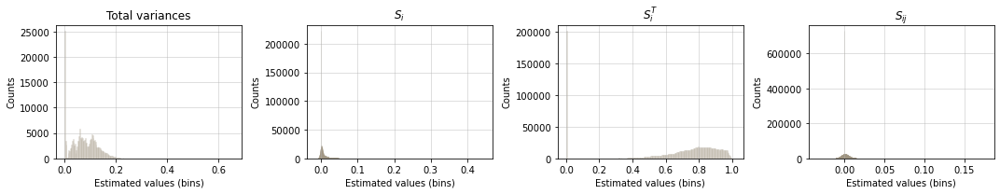

layer1 (0.000103675666, 1.5281465) (-0.017653348, 0.43093106) (0.22988592, 1.0374441) (-0.031146564, 0.14451033)


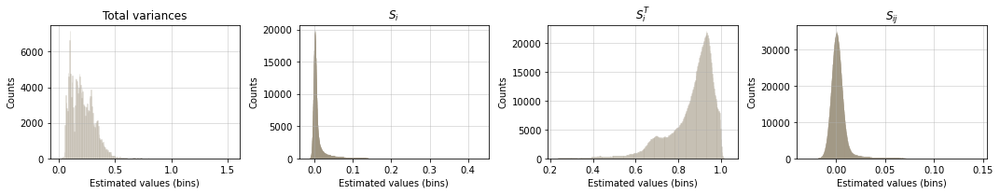

layer2 (0.0026757522, 0.84094733) (-0.016731502, 0.4307913) (0.3497538, 1.0652488) (-0.032981083, 0.1746415)


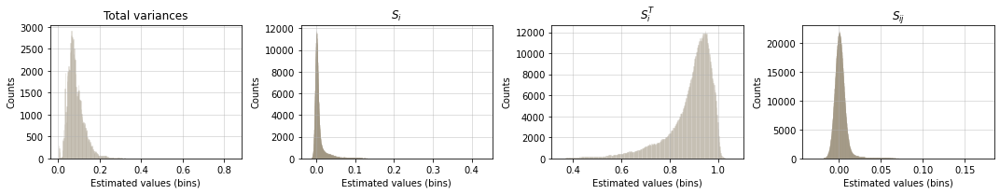

layer3 (0.00010944908, 0.41499564) (-0.015536369, 0.64735687) (0.20221037, 1.1142219) (-0.03666485, 0.1458056)


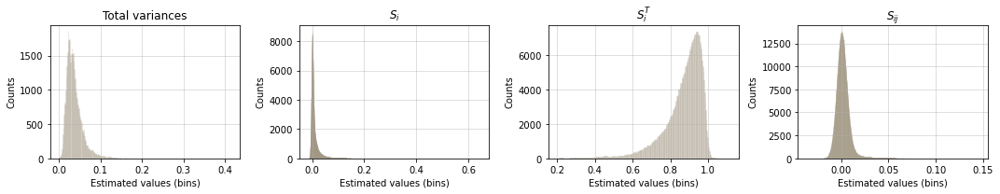

avgpool (0.1776695, 9.548549) (-0.0124907615, 0.7719329) (0.16241908, 0.9926384) (-0.019388897, 0.0810148)


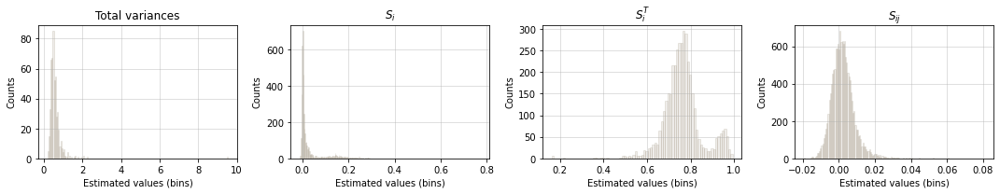

fc (6.34792e-07, 0.003285011) (-0.0459359, 0.60758287) (0.17309457, 2.2581198) (-0.46269968, 0.41505858)


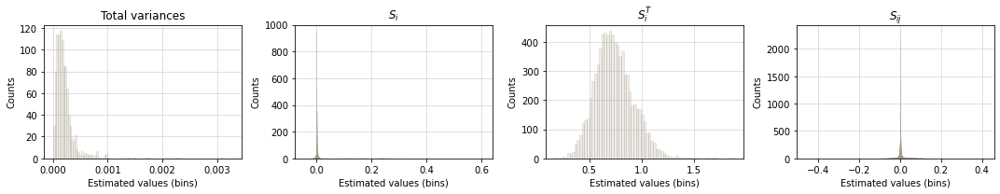

In [27]:
augmentation_set_number = 1

sensitivity_analysis.visualize.si_histograms_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    sitv_path=sitv_results_path_dict[augmentation_set_number],
    **local_params_dict_3_hist,
)

#### 3.3.2 Augmentation set #2

[[Back to subsection]](#3.3-Layer-wise-histograms-of-computed-Sobol-indices)

maxpool (0.0, 1.6181291) (-0.016955175, 0.10674504) (0.0, 1.0250118) (-0.028071573, 0.06701063)


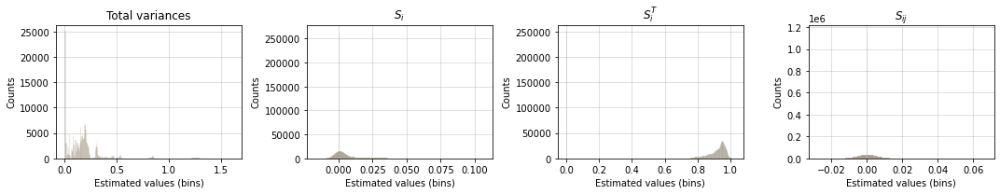

layer1 (0.0002677119, 3.318466) (-0.019580768, 0.22686405) (0.69777906, 1.0267012) (-0.028543305, 0.046883322)


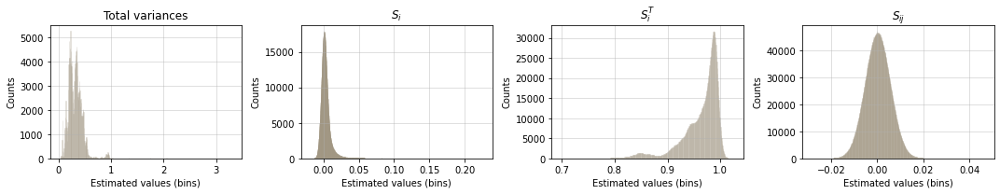

layer2 (0.0005543348, 1.7500135) (-0.018474966, 0.3425007) (0.55364835, 1.0750769) (-0.02673715, 0.09935225)


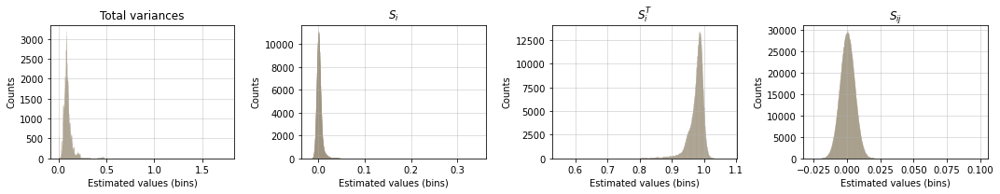

layer3 (8.5822474e-05, 1.1716374) (-0.016317649, 0.33160558) (0.5565087, 1.1337076) (-0.026799627, 0.09208763)


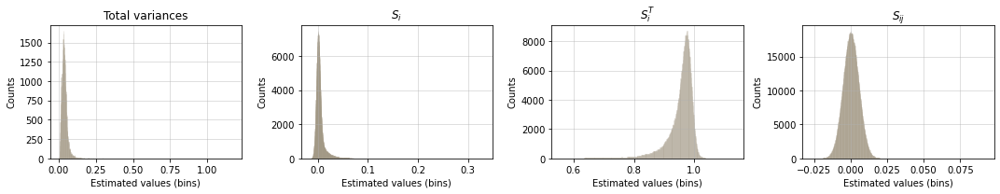

avgpool (0.18217985, 4.870364) (-0.012237695, 0.34032258) (0.52467525, 0.9919554) (-0.023202784, 0.050426595)


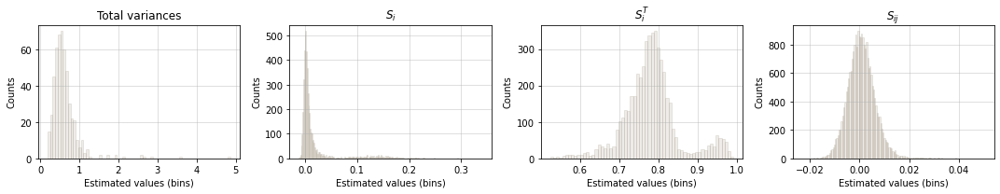

fc (3.0003014e-06, 0.0065239286) (-0.028498927, 0.7178458) (0.07585909, 2.752332) (-0.31405494, 0.45821655)


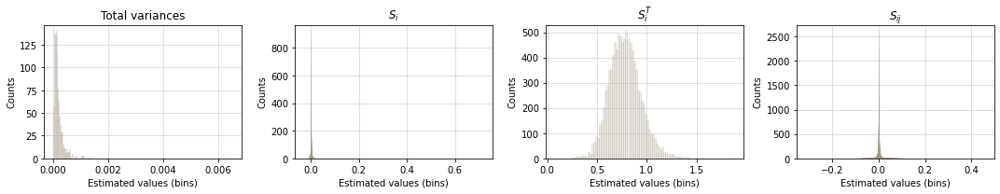

In [28]:
augmentation_set_number = 2

sensitivity_analysis.visualize.si_histograms_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    sitv_path=sitv_results_path_dict[augmentation_set_number],
    **local_params_dict_3_hist,
)

### 3.4 Sobol indices: 1st order and total

[[$\leftarrow$Prev.subsect.]](#3.3-Layer-wise-histograms-of-computed-Sobol-indices)$\quad$[[Back to section]](#3.-Sampling-scheme-1:-Sobol-indices)$\quad$[[Next subsect.$\to$]](#3.5-Sobol-indices:-2nd-order)

- [3.4.1 Augmentation set #1](#3.4.1-Augmentation-set-#1)
- [3.4.2 Augmentation set #2](#3.4.2-Augmentation-set-#2)

#### 3.4.1 Augmentation set #1

[[Back to subsection]](#3.4-Sobol-indices:-1st-order-and-total)

maxpool


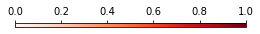

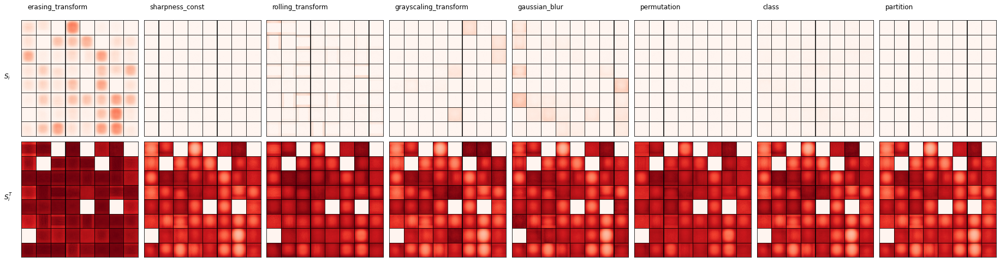

layer1


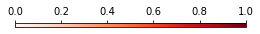

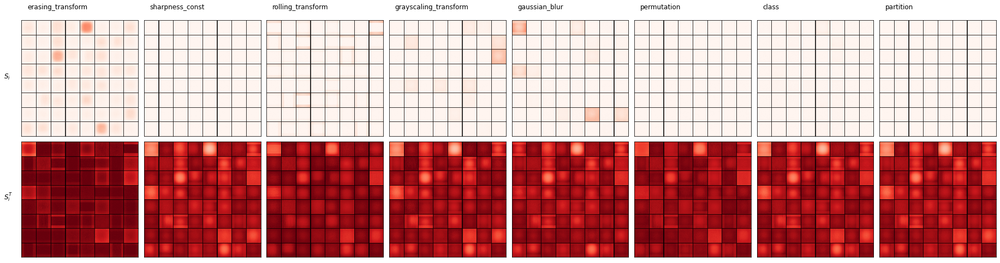

layer2


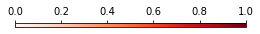

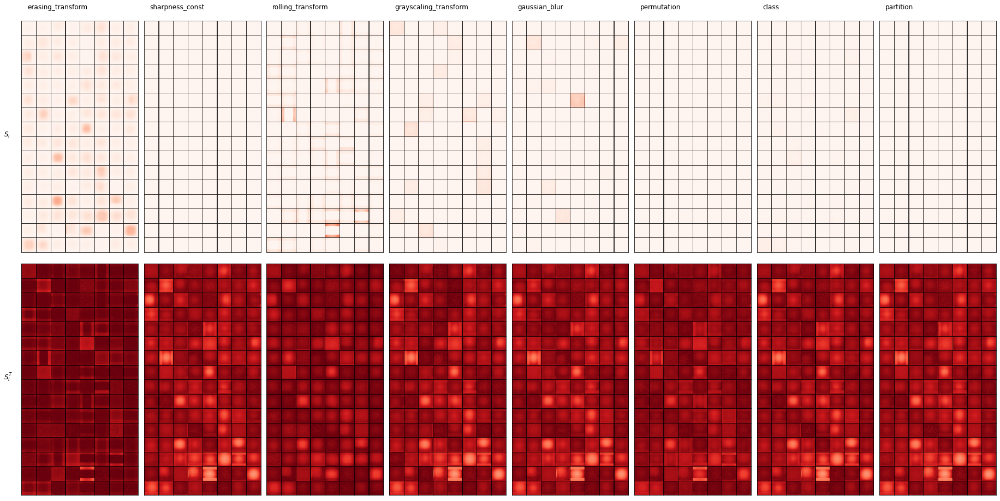

layer3


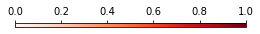

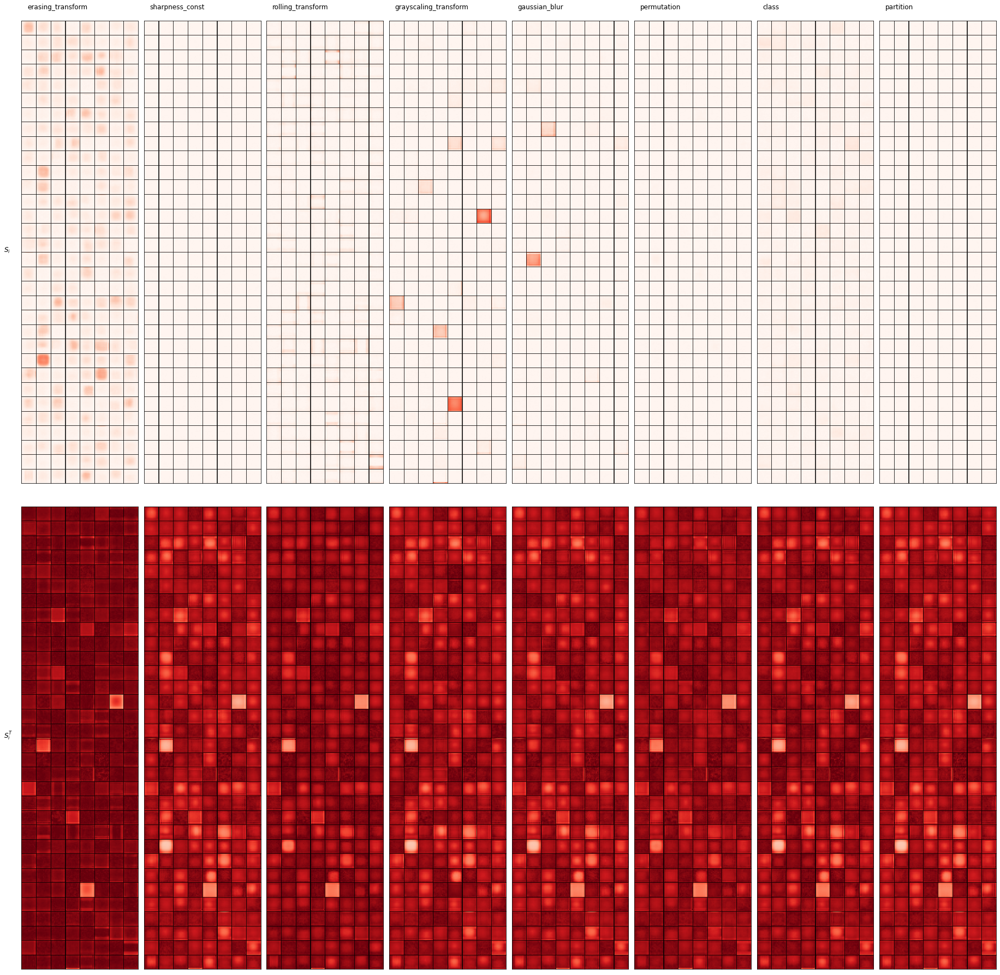

avgpool


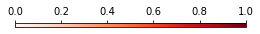

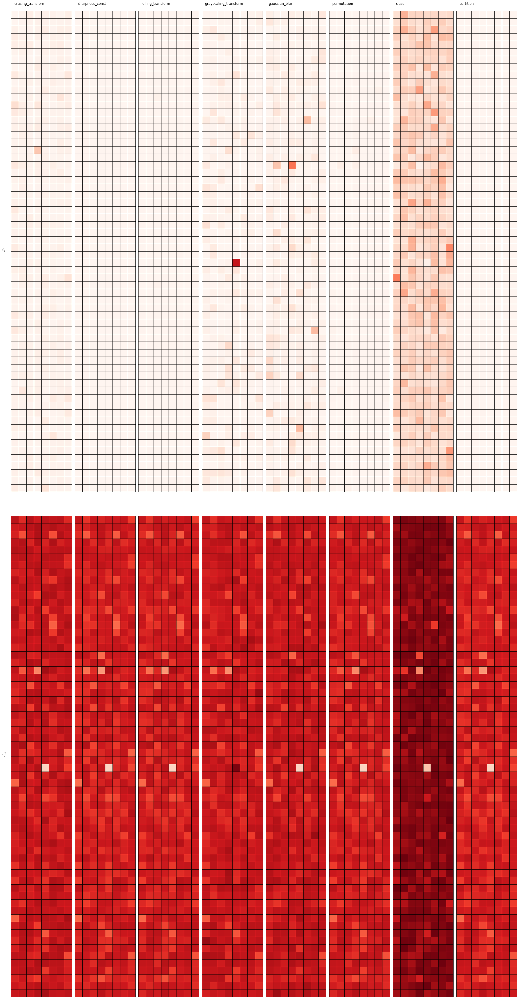

fc


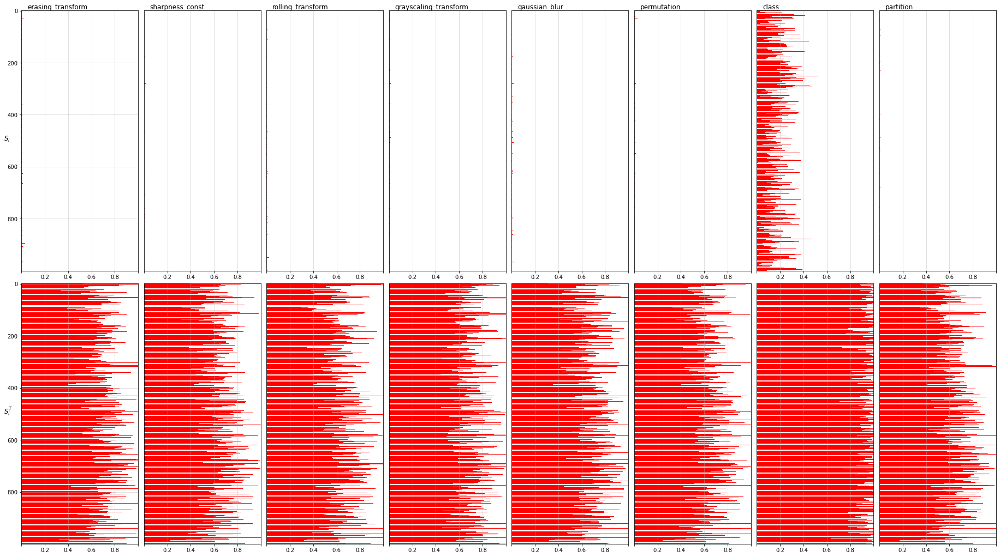

In [29]:
augmentation_set_number = 1

save_dirname = '../results/resnet18/full_sa/'
os.makedirs(save_dirname, exist_ok=True)
save_filename_base = f'resnet18_si_siT_augset={augmentation_set_number}'


sensitivity_analysis.visualize.si_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    values_name='si+sT',
    variable_names=variable_names_dict[augmentation_set_number],
    row_names=row_names,
    n_row_blocks=n_row_blocks,
    show_colorbar=True,
    show=True,
    save_filename_base=save_filename_base,
    save_dirname=save_dirname, 
    **local_params_dict_3,
)

#### 3.4.2 Augmentation set #2

[[Back to subsection]](#3.4-Sobol-indices:-1st-order-and-total)

maxpool


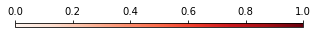

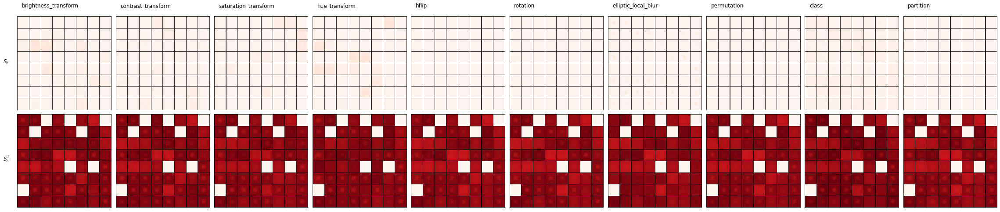

layer1


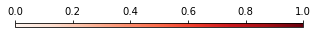

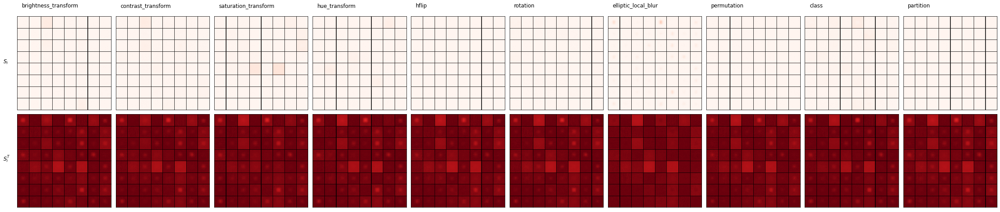

layer2


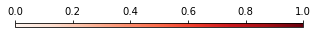

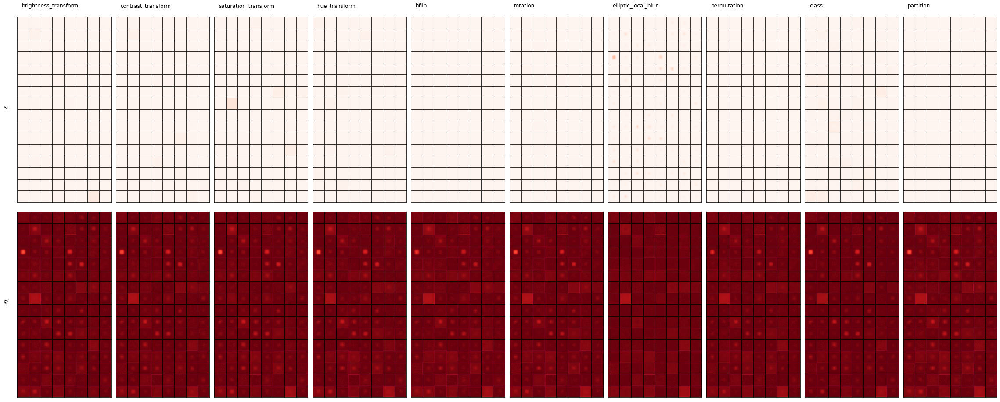

layer3


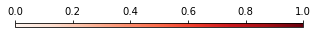

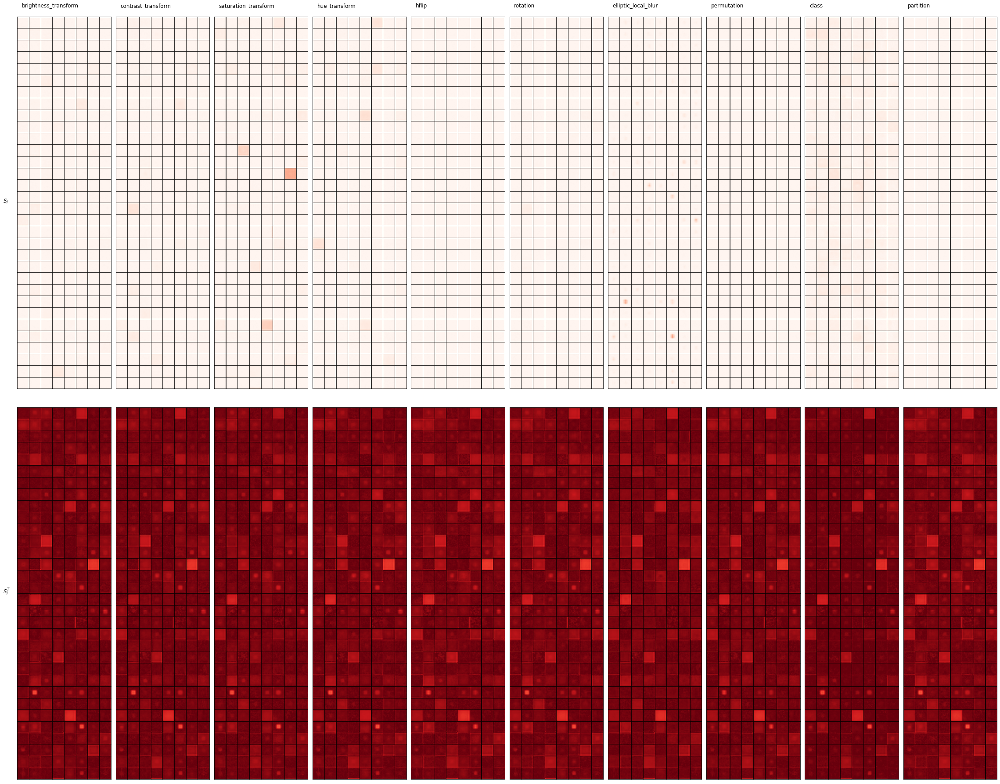

avgpool


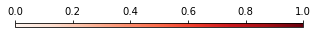

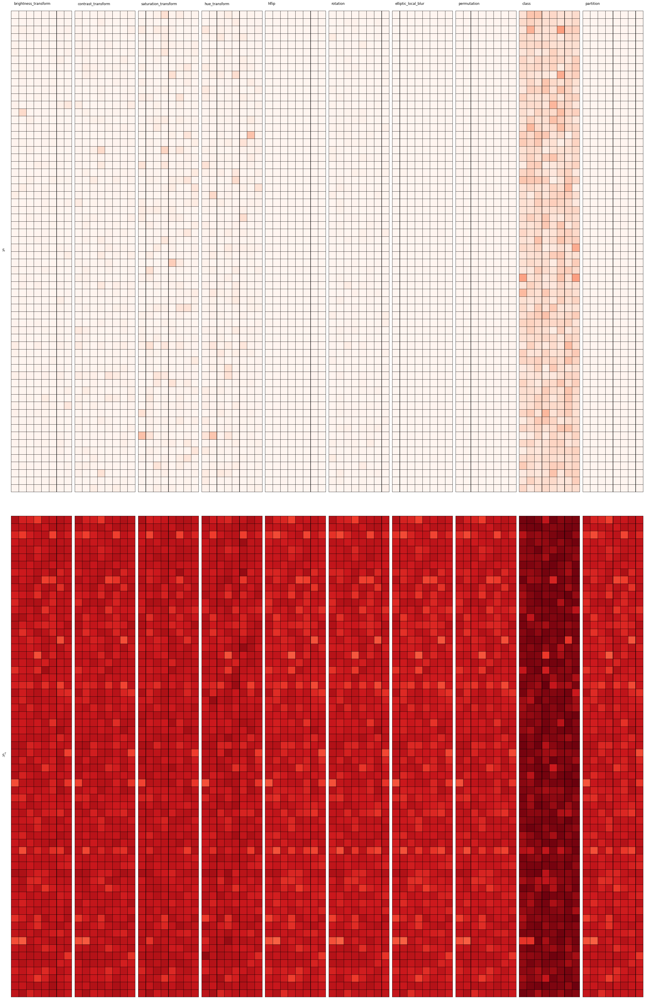

fc


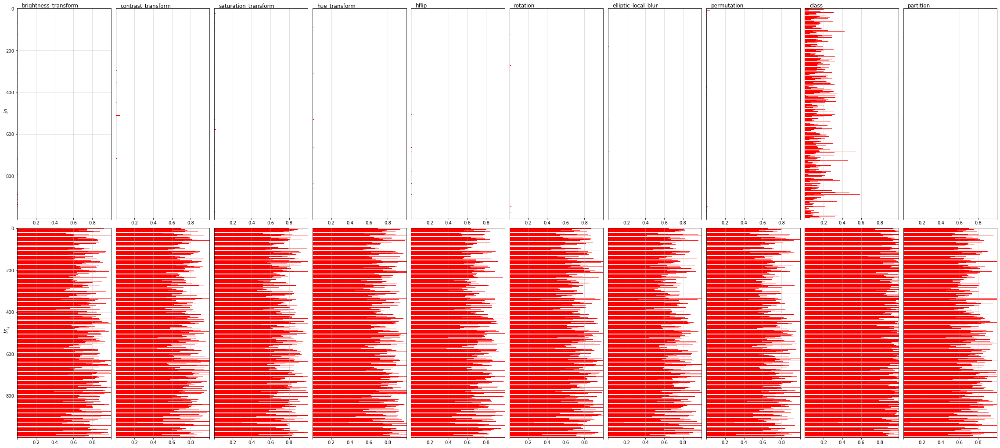

In [30]:
augmentation_set_number = 2

save_dirname = '../results/resnet18/full_sa/'
os.makedirs(save_dirname, exist_ok=True)
save_filename_base = f'resnet18_si_siT_augset={augmentation_set_number}'


sensitivity_analysis.visualize.si_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    values_name='si+sT',
    variable_names=variable_names_dict[augmentation_set_number],
    row_names=row_names,
    n_row_blocks=n_row_blocks,
    show_colorbar=True,
    show=True,
    save_filename_base=save_filename_base,
    save_dirname=save_dirname, 
    **local_params_dict_3,
)

### 3.5 Sobol indices: 2nd order

[[$\leftarrow$Prev.subsect.]](#3.4-Sobol-indices:-1st-order-and-total)$\quad$[[Back to section]](#3.-Sampling-scheme-1:-Sobol-indices)

- [3.5.1 Augmentation set #1](#3.5.1-Augmentation-set-#1)
- [3.5.2 Augmentation set #2](#3.5.2-Augmentation-set-#2)

#### 3.5.1 Augmentation set #1

[[Back to subsection]](#3.5-Sobol-indices:-2nd-order)

maxpool


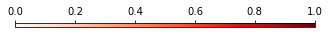

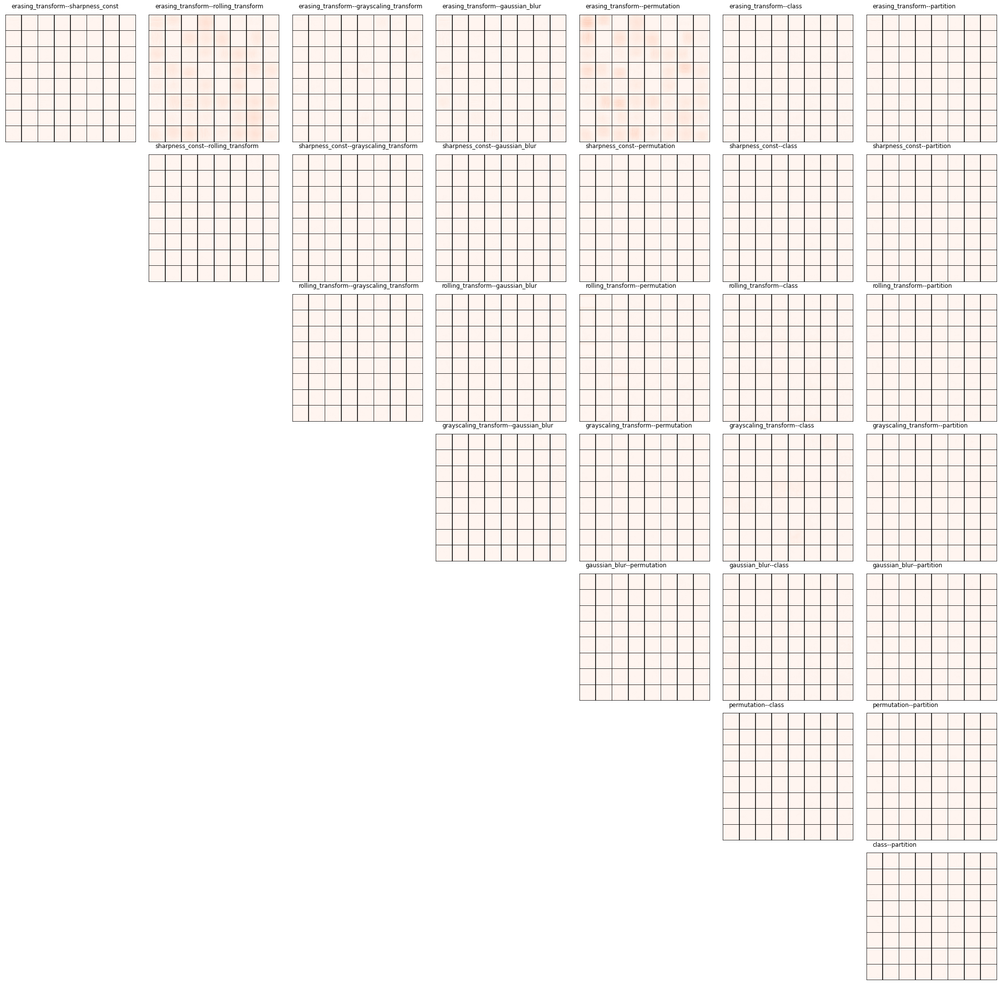

layer1


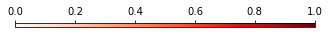

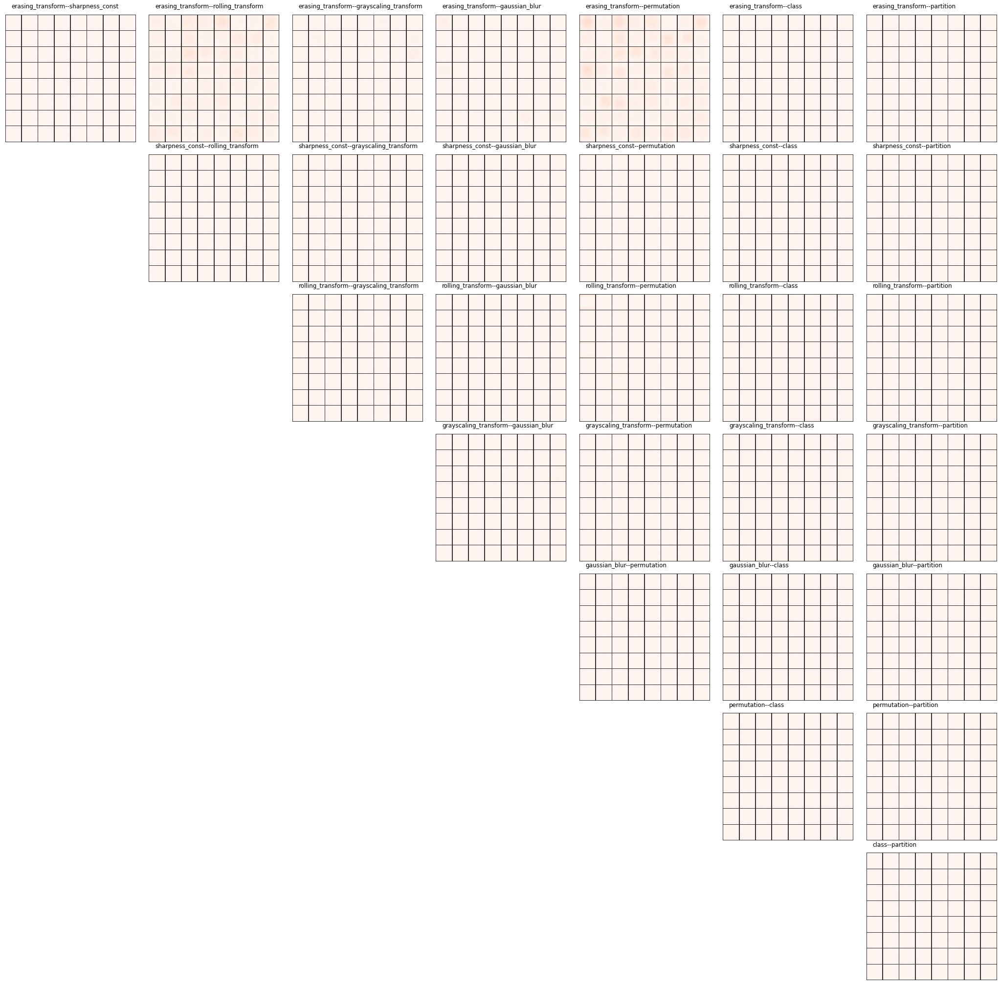

layer2


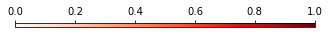

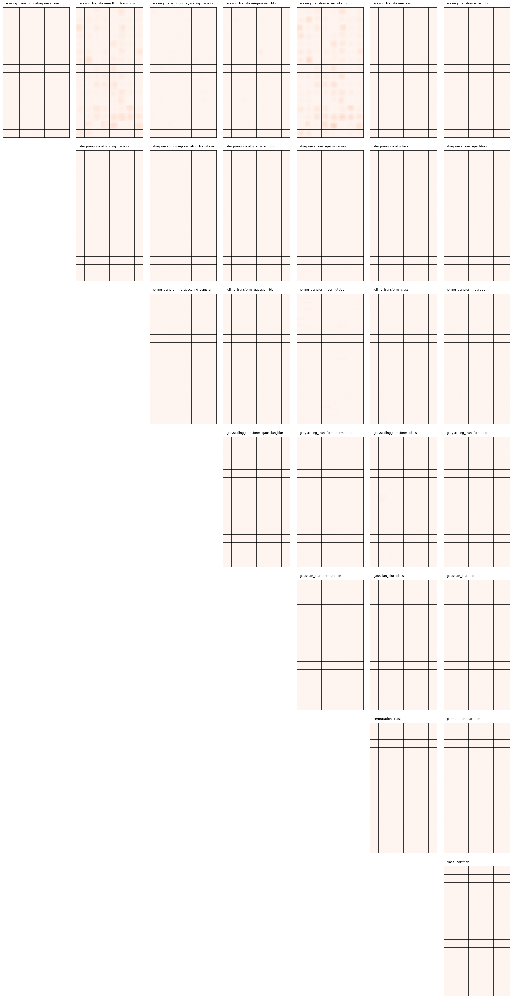

layer3


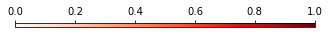

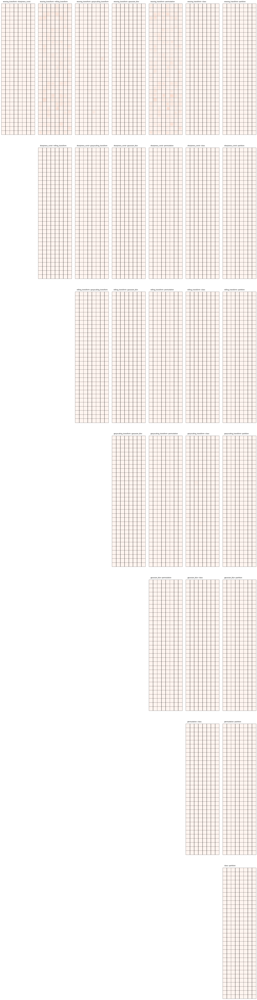

avgpool


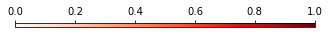

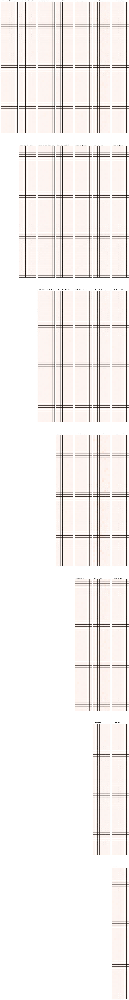

fc


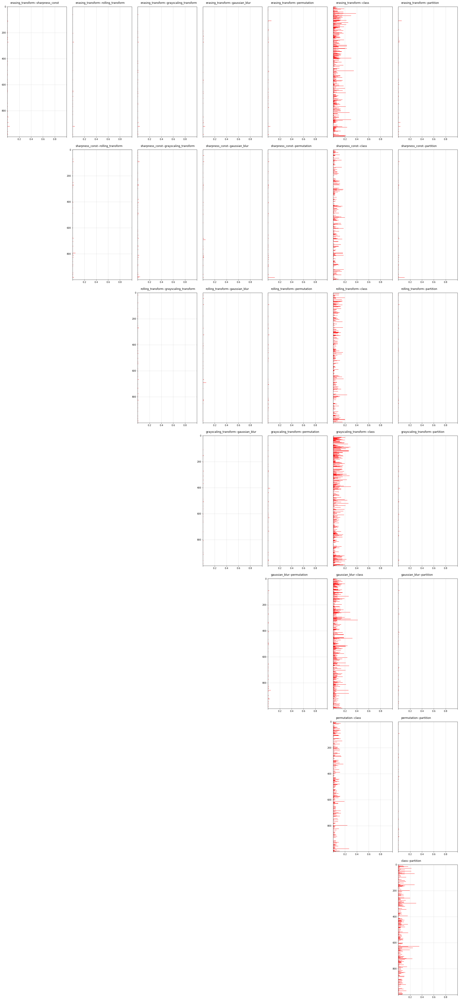

In [80]:
augmentation_set_number = 1

sensitivity_analysis.visualize.si2_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    values_name='si2',
    variable_names=variable_names_dict[augmentation_set_number],
    show_colorbar=True,
    rescale_blocks=False,
    **local_params_dict_3,
)

#### 3.5.2 Augmentation set #2

[[Back to subsection]](#3.5-Sobol-indices:-2nd-order)

maxpool


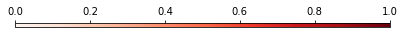

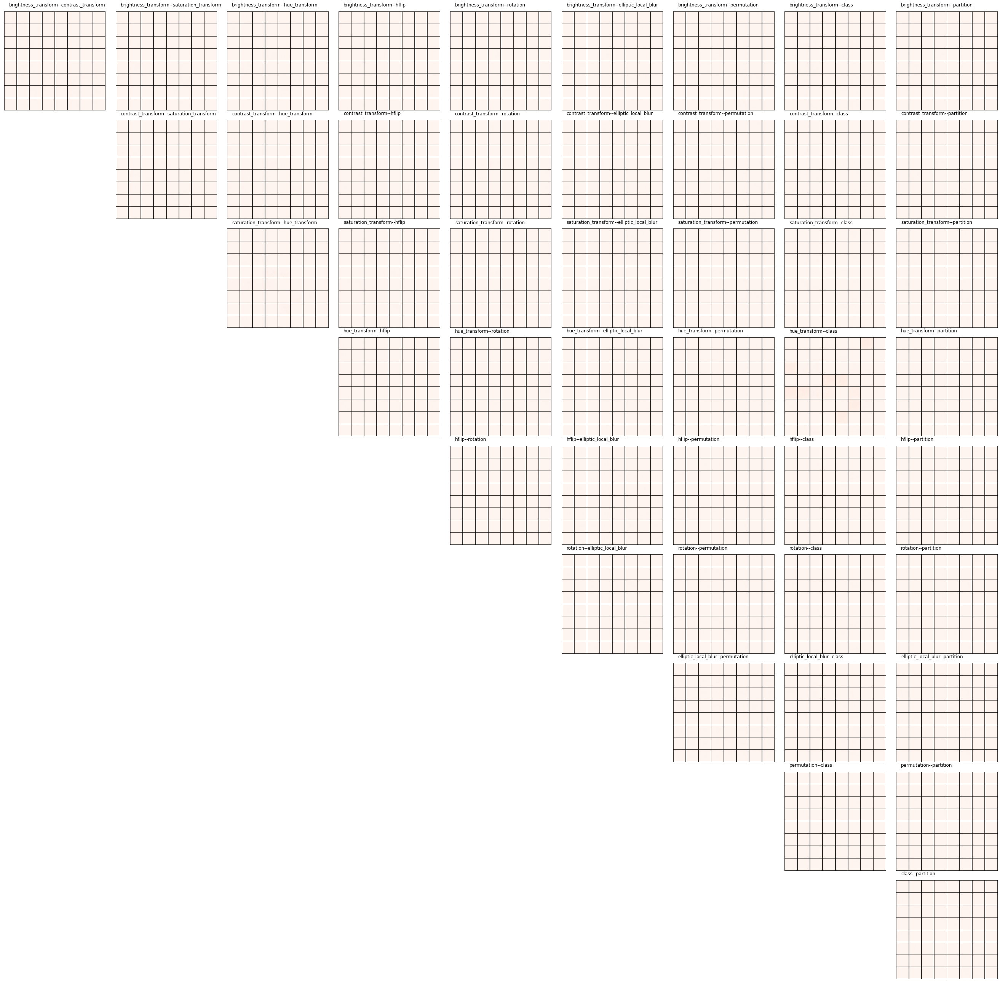

layer1


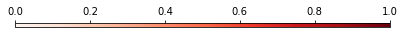

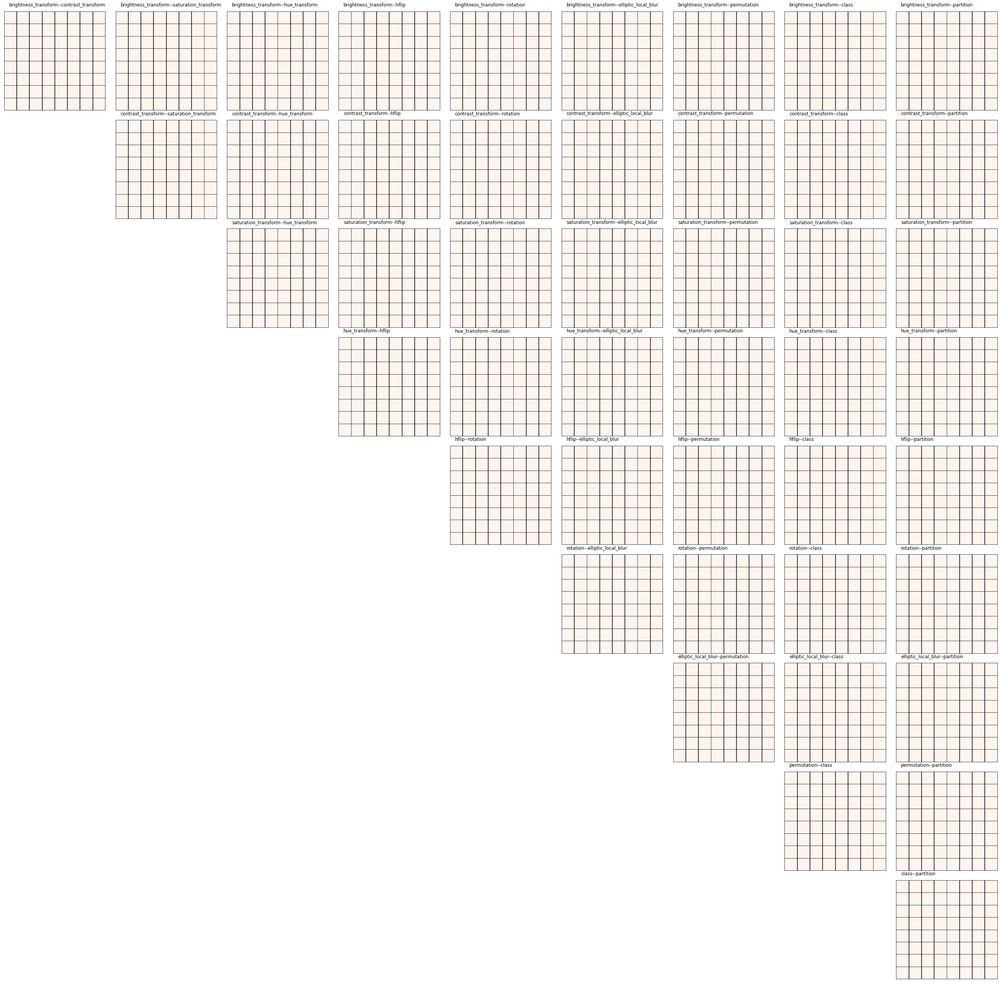

layer2


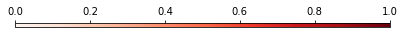

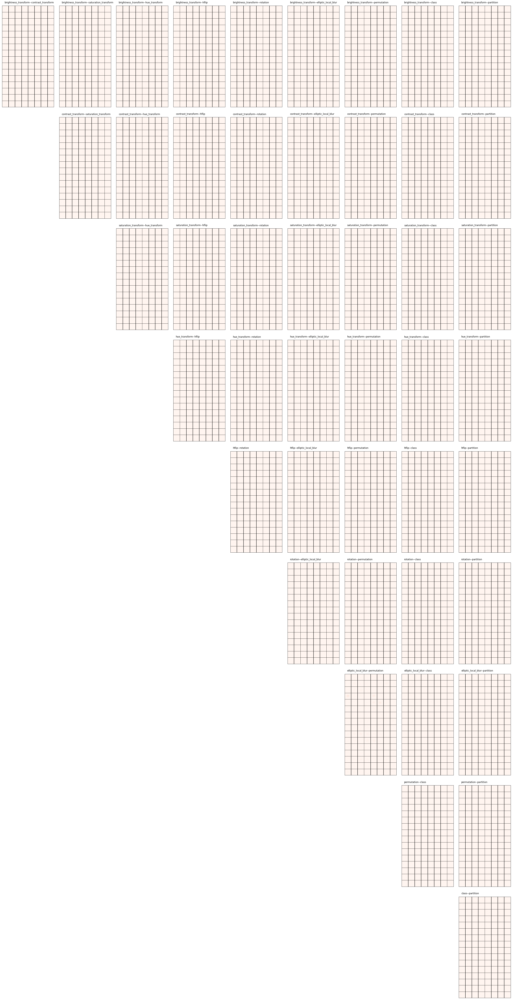

layer3


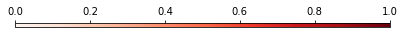

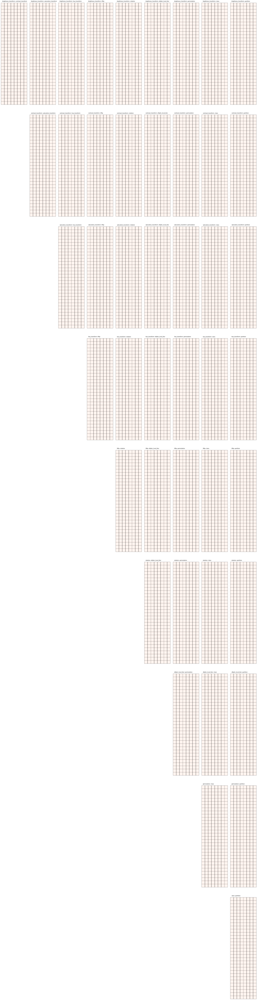

avgpool


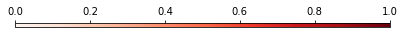

fc


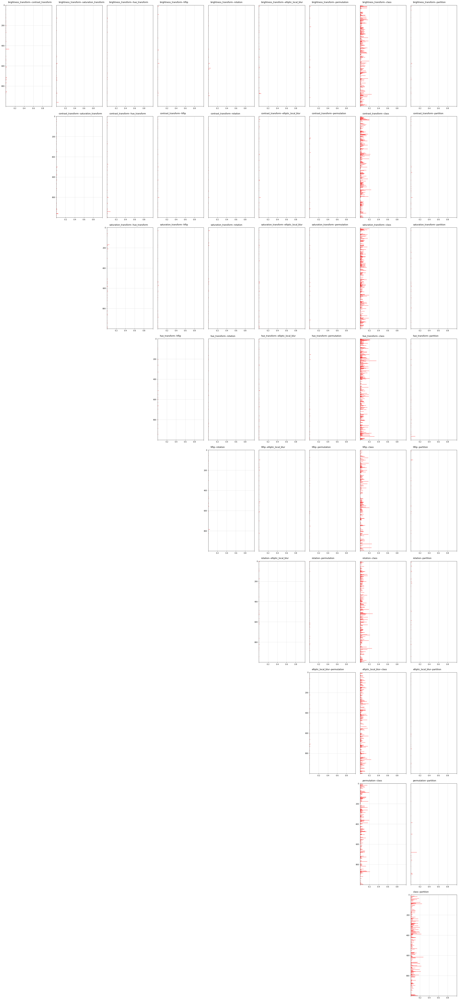

In [81]:
augmentation_set_number = 2

sensitivity_analysis.visualize.si2_compact_plot(
    si_path=si_results_path_dict[augmentation_set_number],
    values_name='si2',
    variable_names=variable_names_dict[augmentation_set_number],
    rescale_blocks=False,
    **local_params_dict_3,
)

## 4. Sampling scheme 2: Summary statistics

[[$\leftarrow$ Prev.part]](#3.-Sampling-scheme-1:-Sobol-indices) $\qquad$ [[Back to top]](#Navigation) $\qquad$ [[Next part $\to$]](#5.-Sampling-scheme-2:-Shapley-values)

- [4.1 Configuring experiments and generating corresponding sh files](#4.1-Configuring-experiments-and-generating-corresponding-sh-files)
- [4.2 Evaluating variables needed to plot the results](#4.2-Evaluating-variables-needed-to-plot-the-results)
- [4.3 Log-transformed (modules of) mean values](#4.3-Log-transformed-(modules-of)-mean-values)
    - [4.3.1 Augmentation set #1](#4.3.1-Augmentation-set-#1)
    - [4.3.2 Augmentation set #2](#4.3.2-Augmentation-set-#2)
- [4.4 Log-transformed total variances](#4.4-Log-transformed-total-variances)
    - [4.4.1 Augmentation set #1](#4.4.1-Augmentation-set-#1)
    - [4.4.2 Augmentation set #2](#4.4.2-Augmentation-set-#2)
- [4.5 Coefficients of Variance](#4.5-Coefficients-of-Variance)
    - [4.5.1 Augmentation set #1](#4.5.1-Augmentation-set-#1)
    - [4.5.2 Augmentation set #2](#4.5.2-Augmentation-set-#2)

### 4.1 Configuring experiments and generating corresponding sh-files

$\quad$[[Back to section]](#4.-Sampling-scheme-2:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#4.2-Evaluating-variables-needed-to-plot-the-results)



```Config_dict``` accumulates all necessary parameters.

In [39]:
config_dict_exp_1_4 = copy.deepcopy(basic_config_dict)

config_dict_exp_1_4['buffer_size_tv_computing'] = 1000
config_dict_exp_1_4['torch_seed'] = 765
config_dict_exp_1_4['numpy_seed'] = 322
config_dict_exp_1_4['class_sampler_seed'] = 987
config_dict_exp_1_4['subset_random_state_train'] = 357
config_dict_exp_1_4['subset_random_state_valid'] = 456
config_dict_exp_1_4['dataset_part'] = 'train+valid'
config_dict_exp_1_4['Njobs_tv_computing'] = n_computing_processes
config_dict_exp_1_4['augset1_p'] = 0.5
config_dict_exp_1_4['augset2_p'] = 0.5
config_dict_exp_1_4['activations_fnm_prefix'] = f'shptv_{network_name}_imagenet_ILSVRC_activations'
config_dict_exp_1_4['values_fnm_prefix'] = f'shptv_{network_name}_imagenet_ILSVRC_values'
config_dict_exp_1_4['Nsamples'] = 2**18
#config_dict['Npermutations'] = 2**8
config_dict_exp_1_4['permutation_random_seed'] = 57
config_dict_exp_1_4['problem_sampler_seed'] = 23
config_dict_exp_1_4['use_partition_variable'] = 1
config_dict_exp_1_4['use_permutation_variable'] = 1
config_dict_exp_1_4['class_selector_seed'] = 201
config_dict_exp_1_4['partition_sampler_seed'] = 256

In [9]:
####################################################################################
script_filename_base = 'script_exp1.4'
exp_filename = '1.4_imagenet_shp_variance.py'
exp_script_path = os.path.join(exp_relative_path, exp_filename)
for augmentation_set_number in [1, 2]:
    config_dict_exp_1_4['augmentation_set_number'] = augmentation_set_number
    current_script_filename = f'{script_filename_base}_aug={augmentation_set_number}.sh'
    
    exp_assistance.build_sh_exp_files(
        config_dict_exp_1_4,
        current_script_filename,
        exp_script_path,
        which=sh_file_type,
    );

### 4.2 Evaluating variables needed to plot the results

[[$\leftarrow$Prev.subsect.]](#4.1-Configuring-experiments-and-generating-corresponding-sh-files)$\quad$[[Back to section]](#4.-Sampling-scheme-2:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#4.3-Log-transformed-(modules-of)-mean-values)

It is supposed that one has already run all necessary experiments and obtained the corresponding results.

In [40]:
# plot the results
dataset_part = config_dict_exp_1_4['dataset_part']
use_switch_variables = False

shptv_results_path_dict = {}
for augmentation_set_number in [1, 2]:
    fnm_suffix = (
        f'part={dataset_part}'
        f'_augnm={augmentation_set_number}'
    )
    shptv_results_path = os.path.join(
        activations_dirname, f'{config_dict_exp_1_4["values_fnm_prefix"]}_{fnm_suffix}.hdf5'
    )
    shptv_results_path_dict[augmentation_set_number] = shptv_results_path
    
n_cols = 8 # min. number of channels = 64, others are divisable on it
n_conv_modules = len(
    list(filter(lambda x: ('maxpool' in x) or ('layer' in x) or ('avgpool' in x), network_module_names))
)
n_rows_fc = 18

In [35]:
local_params_dict_4 = {
    'network_module_names': network_module_names,
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_col_blocks': n_conv_modules,
    'n_rows_fc': n_rows_fc,
    'vmin': vmin,
    'vmax': None,
    #'save_path': None,
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
    'figsize': (15, 30),
    'rescale_conv_blocks': False,
    'fc_height_fraction': 0.1,
    #'show_colorbar': True,
    'global_colorbounds': True,
    'global_bounds_conv_only': True,
}

### 4.3 Log-transformed (modules of) mean values

[[$\leftarrow$Prev.subsect.]](#4.2-Evaluating-variables-needed-to-plot-the-results)$\quad$[[Back to section]](#4.-Sampling-scheme-2:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#4.4-Coefficients-of-Variance)

- [4.3.1 Augmentation set #1](#4.3.1-Augmentation-set-#1)
- [4.3.2 Augmentation set #2](#4.3.2-Augmentation-set-#2)

#### 4.3.1 Augmentation set #1

[[Back to subsection]](#4.3-Log-transformed-(modules-of)-mean-values)

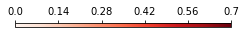

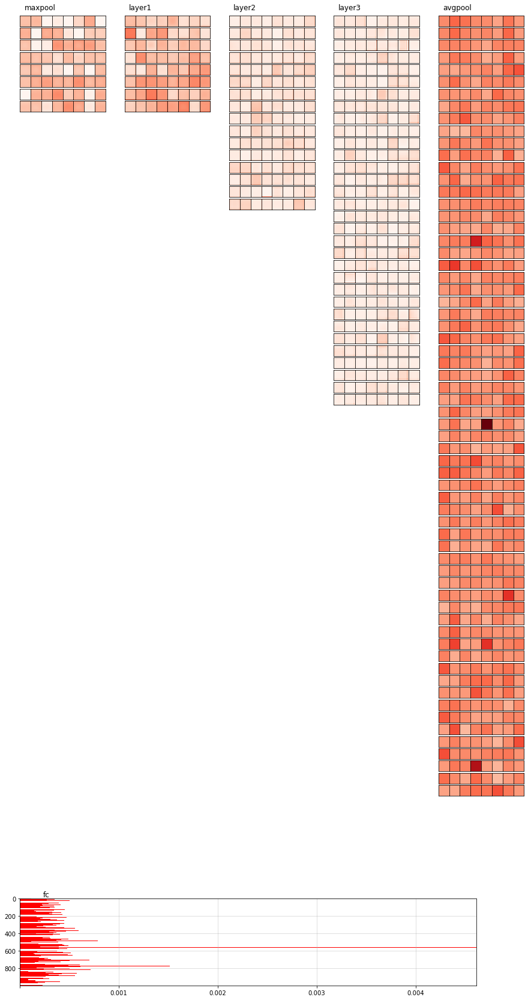

In [41]:
augmentation_set_number = 1

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name='mean',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_4,
)

#### 4.3.2 Augmentation set #2

[[Back to subsection]](#4.3-Log-transformed-(modules-of)-mean-values)

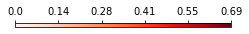

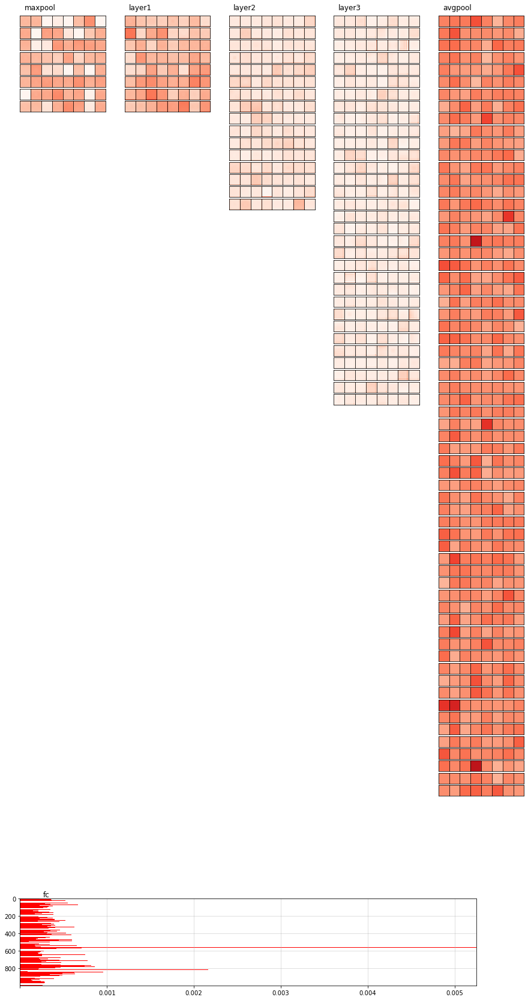

In [42]:
augmentation_set_number = 2

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name='mean',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_4,
)

### 4.4 Log-transformed total variances

[[$\leftarrow$Prev.subsect.]](#4.3-Log-transformed-(modules-of)-mean-values)$\quad$[[Back to section]](#4.-Sampling-scheme-2:-Summary-statistics)$\quad$[[Next subsect.$\to$]](#4.5-Coefficients-of-Variance)

- [4.4.1 Augmentation set #1](#4.4.1-Augmentation-set-#1)
- [4.4.2 Augmentation set #2](#4.4.2-Augmentation-set-#2)

#### 4.4.1 Augmentation set #1

[[Back to subsection]](#4.4-Log-transformed-total-variances)

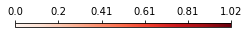

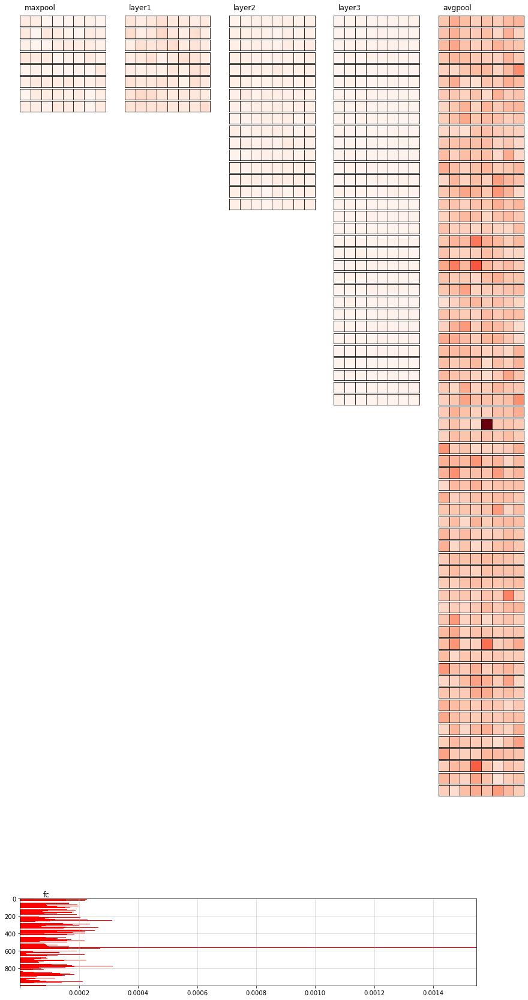

In [36]:
augmentation_set_number = 1

save_dirname = '../results/resnet18/cov_shpv/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_shpv_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_shpv_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name='var',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_4,
)

#### 4.4.2 Augmentation set #2

[[Back to subsection]](#4.4-Log-transformed-total-variances)

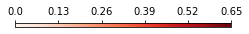

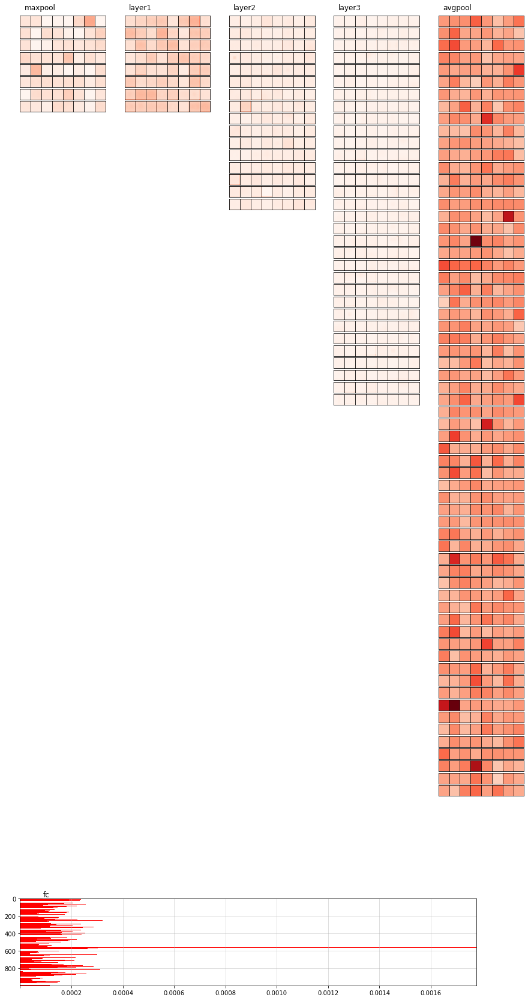

In [37]:
augmentation_set_number = 2

save_dirname = '../results/resnet18/cov_shpv/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_shpv_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_shpv_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name='var',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_4,
)

### 4.5 Coefficients of Variance

[[$\leftarrow$Prev.subsect.]](#4.4-Log-transformed-total-variances)$\quad$[[Back to section]](#4.-Sampling-scheme-2:-Summary-statistics)

- [4.5.1 Augmentation set #1](#4.5.1-Augmentation-set-#1)
- [4.5.2 Augmentation set #2](#4.5.2-Augmentation-set-#2)

#### 4.5.1 Augmentation set #1

[[Back to subsection]](#4.5-Coefficients-of-Variance)

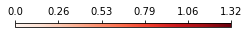

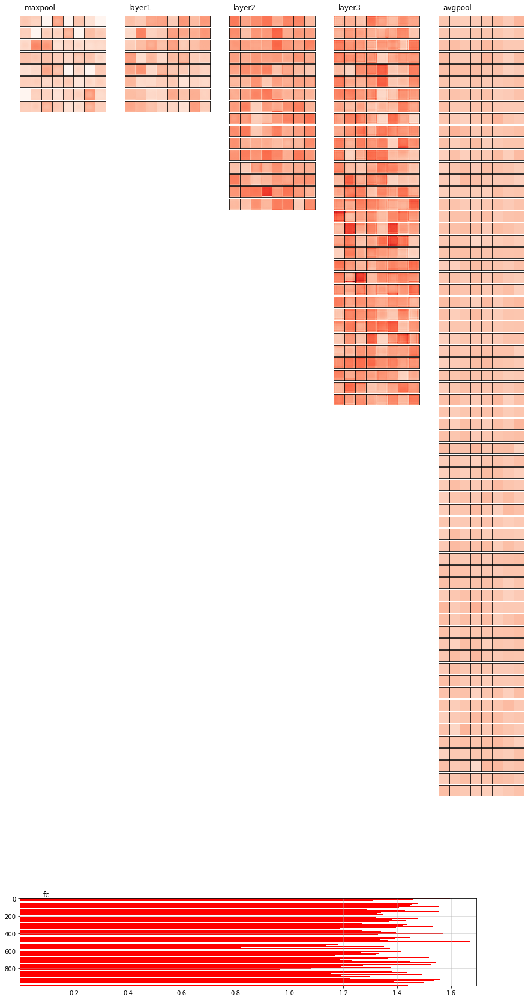

In [38]:
augmentation_set_number = 1

save_dirname = '../results/resnet18/cvs_shpv/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_shpv_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_shpv_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name=('var', 'mean'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_coef_var,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_4,
)

#### 4.5.2 Augmentation set #2

[[Back to subsection]](#4.5-Coefficients-of-Variance)

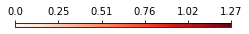

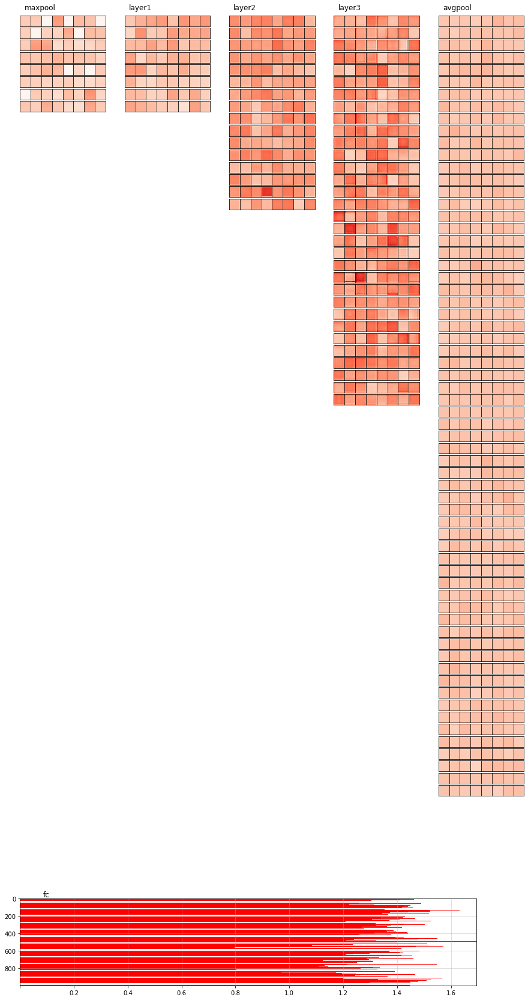

In [39]:
augmentation_set_number = 2

save_dirname = '../results/resnet18/cvs_shpv/'
os.makedirs(save_dirname, exist_ok=True)
save_filename = f'resnet18_shpv_augset={augmentation_set_number}.pdf'
save_colorbar = f'resnet18_shpv_augset={augmentation_set_number}_colorbar.pdf'

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shptv_results_path_dict[augmentation_set_number],
    values_name=('var', 'mean'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_coef_var,
    show_colorbar=True,
    save_path=os.path.join(save_dirname, save_filename),
    colorbar_path=os.path.join(save_dirname, save_colorbar),
    **local_params_dict_4,
)

## 5. Sampling scheme 2: Shapley values

[[$\leftarrow$ Prev.part]](#4.-Sampling-scheme-2:-Summary-statistics) $\qquad$ [[Back to top]](#Navigation)

- [5.1 Configuring experiments and generating corresponding sh-files](#5.1-Configuring-experiments-and-generating-corresponding-sh-files)
- [5.2 Evaluating variables needed to plot the results](#5.2-Evaluating-variables-needed-to-plot-the-results)
- [5.3 Layer wise histograms of computed Shapley values](#5.3-Layer-wise-histograms-of-computed-Shapley-values)
    - [5.3.1 Augmentation set #1](#5.3.1-Augmentation-set-#1)
    - [5.3.2 Augmentation set #2](#5.3.2-Augmentation-set-#2)
- [5.4 Shapley values](#5.4-Shapley-values)
    - [5.4.1 Augmentation set #1](#5.4.1-Augmentation-set-#1)
    - [5.4.2 Augmentation set #2](#5.4.2-Augmentation-set-#2)
- [5.5 Log-transformed (modules of) mean values](#5.5-Log-transformed-(modules-of)-mean-values)
    - [5.5.1 Augmentation set #1](#5.5.1-Augmentation-set-#1)
    - [5.5.2 Augmentation set #2](#5.5.2-Augmentation-set-#2)
- [5.6 Log-transformed (total) variances](#5.6-Log-transformed-(total)-variances)
    - [5.6.1 Augmentation set #1](#5.6.1-Augmentation-set-#1)
    - [5.6.2 Augmentation set #2](#5.6.2-Augmentation-set-#2)
- [5.7 Coefficients of Variance](#5.7-Coefficients-of-Variance)
    - [5.7.1 Augmentation set #1](#5.7.1-Augmentation-set-#1)
    - [5.7.2 Augmentation set #2](#5.7.2-Augmentation-set-#2)
    
  


### 5.1 Configuring experiments and generating corresponding sh-files

$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.2-Evaluating-variables-needed-to-plot-the-results)

```Config_dict``` accumulates all necessary parameters.

In [21]:
config_dict_exp_1_5 = copy.deepcopy(basic_config_dict)

config_dict_exp_1_5['buffer_size_shpv_computing'] = 1000
config_dict_exp_1_5['torch_seed'] = 765
config_dict_exp_1_5['numpy_seed'] = 322
config_dict_exp_1_5['class_sampler_seed'] = 987
config_dict_exp_1_5['subset_random_state_train'] = 357
config_dict_exp_1_5['subset_random_state_valid'] = 456
config_dict_exp_1_5['dataset_part'] = 'train+valid'
config_dict_exp_1_5['Njobs_shpv_computing'] = n_computing_processes
config_dict_exp_1_5['augset1_p'] = 0.5
config_dict_exp_1_5['augset2_p'] = 0.5
config_dict_exp_1_5['activations_fnm_prefix'] = f'shpv_{network_name}_imagenet_ILSVRC_activations'
config_dict_exp_1_5['values_fnm_prefix'] = f'shpv_{network_name}_imagenet_ILSVRC_values'
config_dict_exp_1_5['Nouter_samples'] = 2**6 # 5
config_dict_exp_1_5['Ninner_samples'] = 2**3 # 3
config_dict_exp_1_5['Npermutations'] = 2**8 # 7
config_dict_exp_1_5['permutation_random_seed'] = 562
config_dict_exp_1_5['problem_sampler_seed'] = 281
config_dict_exp_1_5['use_partition_variable'] = 1
config_dict_exp_1_5['use_permutation_variable'] = 1
config_dict_exp_1_5['class_selector_seed'] = 201
config_dict_exp_1_5['partition_sampler_seed'] = 256

In [ ]:
####################################################################################
script_filename_base = 'script_exp1.5'
exp_filename = '1.5_imagenet_shapley.py'
exp_script_path = os.path.join(exp_relative_path, exp_filename)
for augmentation_set_number in [1, 2]:
    config_dict_exp_1_5['augmentation_set_number'] = augmentation_set_number
    current_script_filename = f'{script_filename_base}_aug={augmentation_set_number}.sh'
    
    exp_assistance.build_sh_exp_files(
        config_dict_exp_1_5,
        current_script_filename,
        exp_script_path,
        which=sh_file_type,
    );

### 5.2 Evaluating variables needed to plot the results

[[$\leftarrow$Prev.subsect.]](#5.1-Configuring-experiments-and-generating-corresponding-sh-files)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.3-Layer-wise-histograms-of-computed-Shapley-values)



In [22]:
# plot the results
dataset_part = config_dict_exp_1_5['dataset_part']
use_switch_variables = False

shptv_values_fnm_prefix = f'shptv_{network_name}_imagenet_ILSVRC_values'

shptv_results_path_dict = {}
shpv_results_path_dict = {}
variable_names_dict = {}
group_indices_dict = {}
for augmentation_set_number in [1, 2]:
    fnm_suffix = (
        f'part={dataset_part}'
        f'_augnm={augmentation_set_number}'
    )
    shpv_results_path = os.path.join(
        activations_dirname, f'{config_dict_exp_1_5["values_fnm_prefix"]}_{fnm_suffix}.hdf5'
    )
    shpv_results_path_dict[augmentation_set_number] = shpv_results_path
    shptv_results_path = os.path.join(
        activations_dirname, f'{shptv_values_fnm_prefix}_{fnm_suffix}.hdf5'
    )
    shptv_results_path_dict[augmentation_set_number] = shptv_results_path
    
    variable_names_dict[
        augmentation_set_number
    ] = sensitivity_analysis.augmentation_setting.get_augmentation_transforms_names(
        augmentation_set_number,
        use_permutation_variable=config_dict_exp_1_5['use_permutation_variable'],
        use_class_variable=True,
        use_partition_variable=config_dict_exp_1_5['use_partition_variable']
    )
    group_indices_dict[
        augmentation_set_number
    ] = sensitivity_analysis.augmentation_setting.get_group_variables_indices(
        augmentation_set_number,
        use_permutation_variable=config_dict_exp_1_5['use_permutation_variable'],
        use_class_variable=True,
        use_partition_variable=config_dict_exp_1_5['use_partition_variable']
    )
    
n_rows_fc = 18
n_cols = 8 # min. number of channels = 64, others are divisable on it
n_conv_modules = len(
    list(filter(lambda x: ('maxpool' in x) or ('layer' in x) or ('avgpool' in x), network_module_names))
)

normalize_shpv = True
vmin, vmax = None, None
if normalize_shpv:
    vmin, vmax = 0, 1

In [25]:
local_params_dict_5_hist = {
    'network_module_names': network_module_names,
    'variable_names': ('shpv', 'var'),
    'figsize': (10, 3),
    'zero_atol': 1e-4,
    'eps': 1e-6,
}

local_params_dict_5_shpv = {
    'network_module_names': network_module_names,
    'values_name': 'shpv',
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_rows_fc': n_rows_fc,
    'vmin': vmin,
    'vmax': vmax,
    'normalize': True,
    'eps': 1e-20, #1e-6
    #figsize=(30, 3),
    'figsize': 3,
    #'save_filename_base': None,
    #'save_dirname': None, 
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
    #'show_colorbar': True,
    'global_colorbounds': False, # already in [0, 1]
    'global_bounds_conv_only': False,
}

local_params_dict_5_shpv_sum = {
    'network_module_names': network_module_names,
    'n_conv_modules': n_conv_modules,
    'n_cols': n_cols,
    'n_col_blocks': n_conv_modules,
    'n_rows_fc': n_rows_fc,
    'vmin': 0,
    'vmax': None,
    'save_path': None,
    'conv2d_cmap_name': 'Reds',
    'fc_color_name': 'red',
    'figsize': (15, 30),
    'rescale_conv_blocks': False,
    'fc_height_fraction': 0.1,
    'show_colorbar': True,
    'global_colorbounds': True,
    'global_bounds_conv_only': True,
}

### 5.3 Layer wise histograms of computed Shapley values

[[$\leftarrow$Prev.subsect.]](#5.2-Evaluating-variables-needed-to-plot-the-results)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.4-Shapley-values)

- [5.3.1 Augmentation set #1](#5.3.1-Augmentation-set-#1)
- [5.3.2 Augmentation set #2](#5.3.2-Augmentation-set-#2)

#### 5.3.1 Augmentation set #1

[[Back to subsection]](#5.3-Layer-wise-histograms-of-computed-Shapley-values)

maxpool (0.0, 0.6552944) (0.0, 0.6612188331864672) (0.0, 0.26311527064535767) (0.0, 0.5754576057401348)


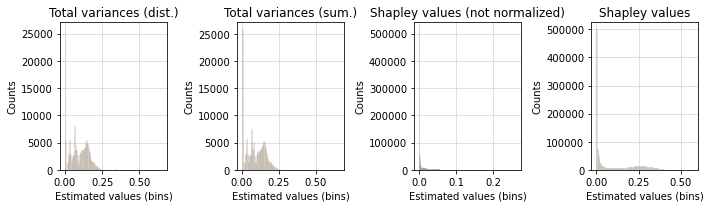

layer1 (0.00033291796, 1.4249004) (0.0004895008872795733, 1.4422766916426304) (0.0, 0.552914792438969) (0.0, 0.566587852331877)


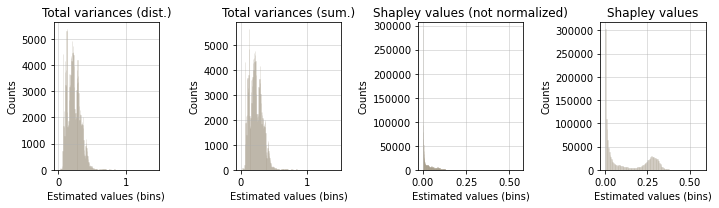

layer2 (0.0021846339, 1.0091127) (0.002279257646113258, 1.0139723464817507) (0.0, 0.4234418513951823) (0.0, 0.5302797420839633)


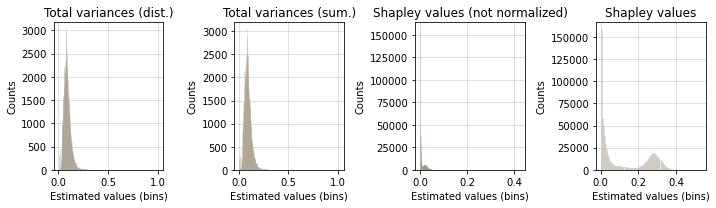

layer3 (9.054576e-05, 0.53454304) (0.00011591471759510309, 0.5400477117045739) (0.0, 0.23076623410452157) (0.0, 0.6716097594738748)


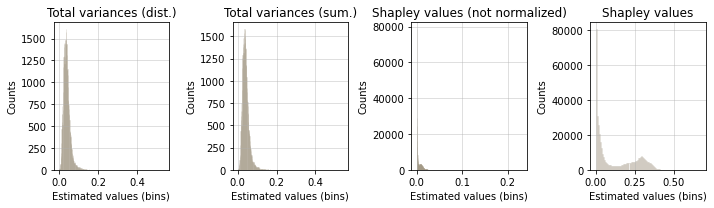

avgpool (0.2987252, 9.35998) (0.3036267540537665, 9.388663446914506) (0.0, 7.30972128175199) (0.0, 0.7785688074254544)


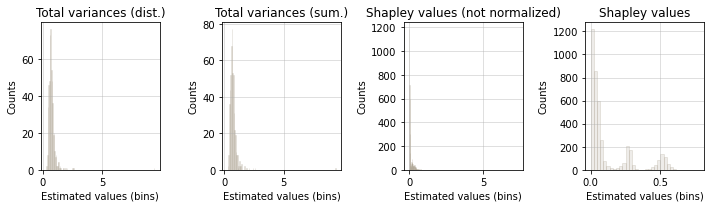

fc (1.1907331e-05, 0.0035667068) (1.7197551222104804e-05, 0.0036925223107684424) (0.0, 0.0015183193443135679) (0.0, 0.7924100194629865)


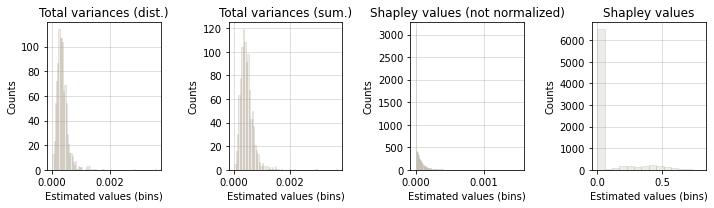

In [49]:
# plot histograms of values per layer
augmentation_set_number = 1

sensitivity_analysis.visualize.shp_histograms_compact_plot(
    shpv_path=shpv_results_path_dict[augmentation_set_number],
    shptv_path=shptv_results_path_dict[augmentation_set_number],
    shp_values_func=lambda x: sensitivity_analysis.preprocess_visualize.hist_shp_values_func(
        x, group_indices_dict[augmentation_set_number]
    ),
    **local_params_dict_5_hist,
)

#### 5.3.2 Augmentation set #2

[[Back to subsection]](#5.3-Layer-wise-histograms-of-computed-Shapley-values)

maxpool (0.0, 0.75386333) (0.0, 0.7571974297006016) (0.0, 0.29027413995936513) (0.0, 0.45236752631698735)


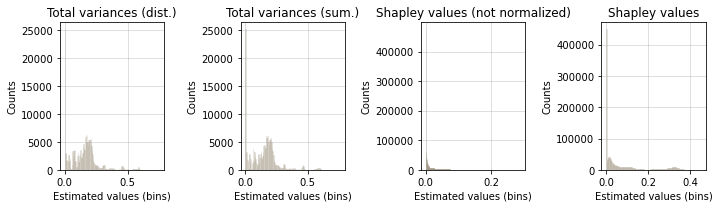

layer1 (0.00046554464, 1.6449643) (0.0006995754620112318, 1.653800810858229) (0.0, 0.6191163917537779) (0.0, 0.4566958325163569)


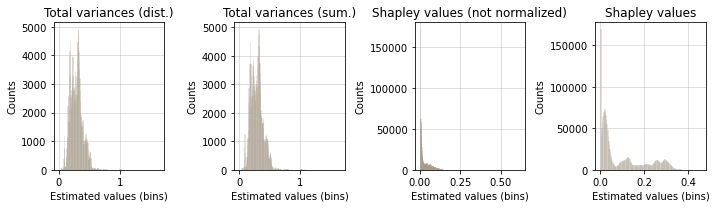

layer2 (0.00077528774, 1.4582667) (0.0008610587110217648, 1.4799198751352378) (0.0, 0.5648991451598704) (0.0, 0.5578782120880419)


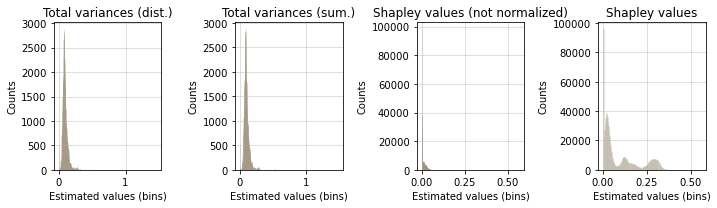

layer3 (9.603672e-05, 0.9710173) (0.0001280759530410076, 0.9993735799571368) (0.0, 0.3753421633737162) (0.0, 0.5407029970267869)


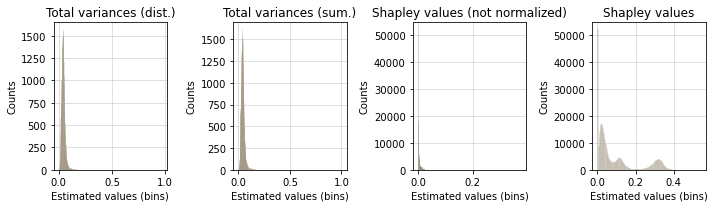

avgpool (0.30666557, 3.4219282) (0.3093042848419145, 3.477790084143635) (0.0, 1.5315423652064055) (0.0, 0.642148667487605)


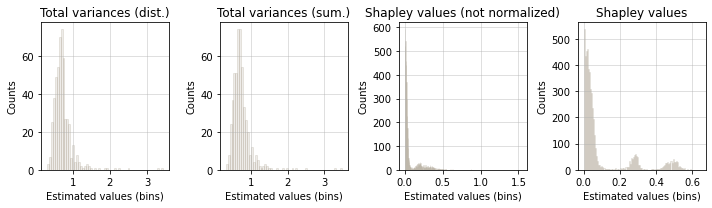

fc (2.4588777e-05, 0.0041022957) (3.418045233519372e-05, 0.004730626623686618) (0.0, 0.0016899671879855305) (0.0, 0.703038527825338)


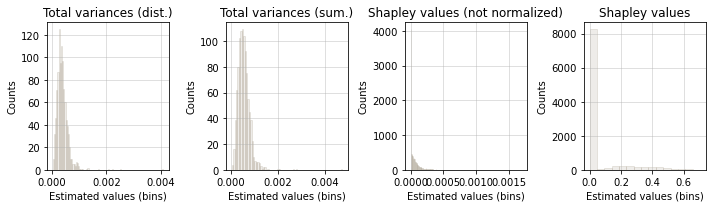

In [50]:
# plot histograms of values per layer
augmentation_set_number = 2

sensitivity_analysis.visualize.shp_histograms_compact_plot(
    shpv_path=shpv_results_path_dict[augmentation_set_number],
    shptv_pathshptv_results_path_dict[augmentation_set_number],
    shp_values_func=lambda x: sensitivity_analysis.preprocess_visualize.hist_shp_values_func(
        x, group_indices_dict[augmentation_set_number]
    ),
    **local_params_dict_5_hist,
)

### 5.4 Shapley values

[[$\leftarrow$Prev.subsect.]](#5.3-Layer-wise-histograms-of-computed-Shapley-values)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.5-Log-transformed-(modules-of)-mean-values)

- [5.4.1 Augmentation set #1](#5.4.1-Augmentation-set-#1)
- [5.4.2 Augmentation set #2](#5.4.2-Augmentation-set-#2)

Note: on the following plots, all values were clipped to be bounded in [0, 1] interval.

#### 5.4.1 Augmentation set #1

[[Back to subsection]](#5.4-Shapley-values)

maxpool


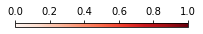

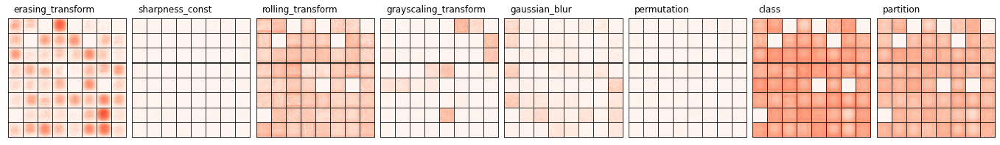

layer1


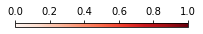

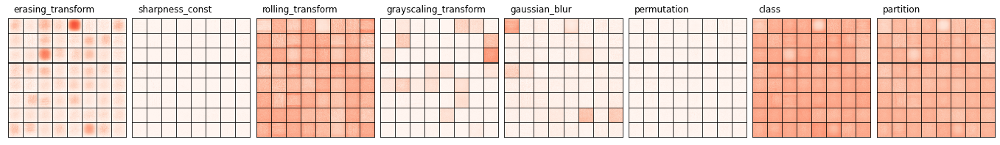

layer2


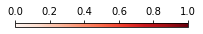

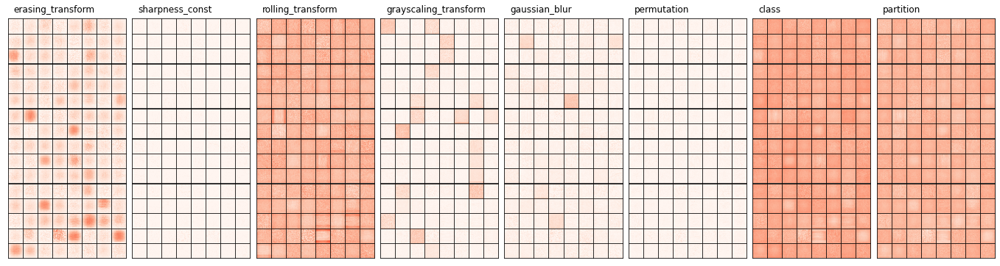

layer3


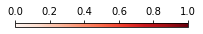

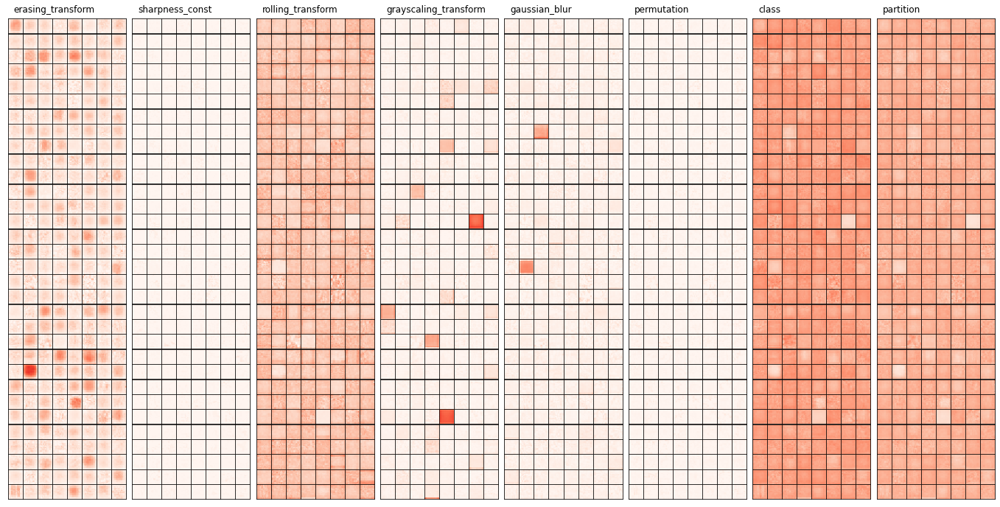

avgpool


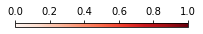

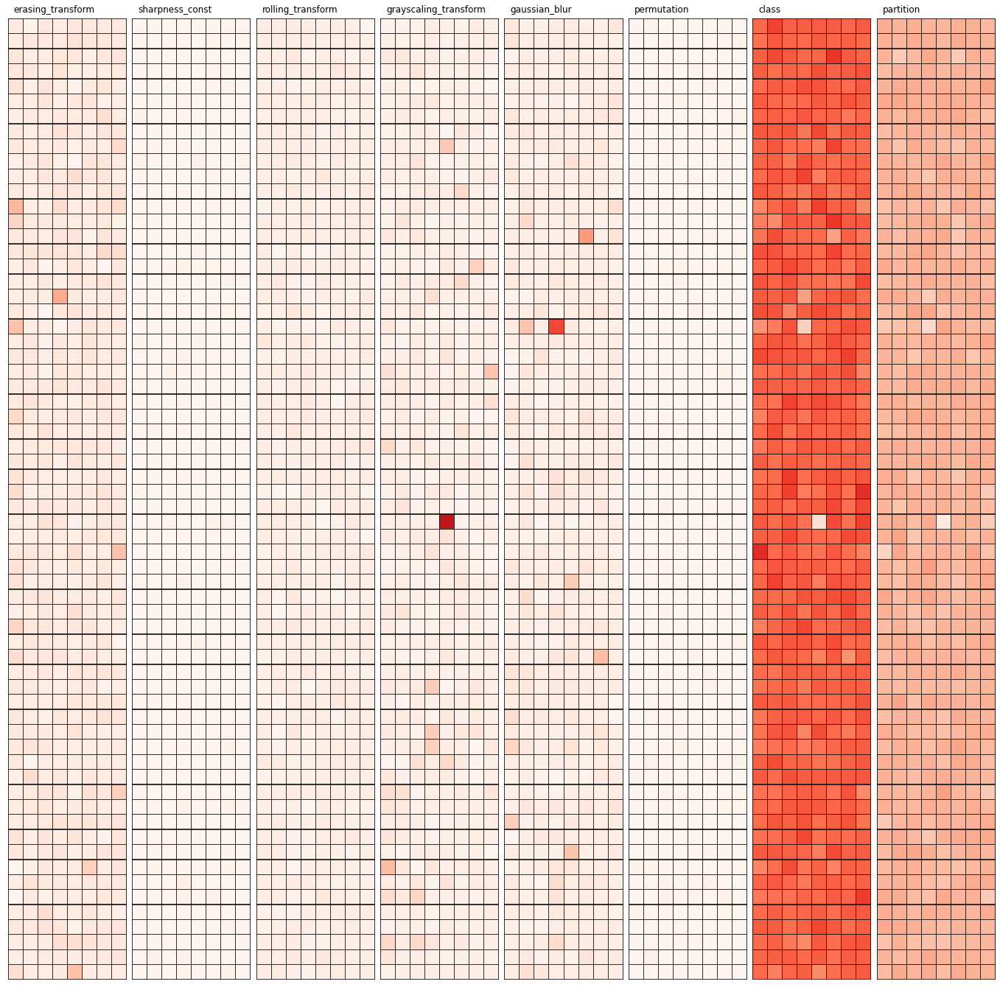

fc


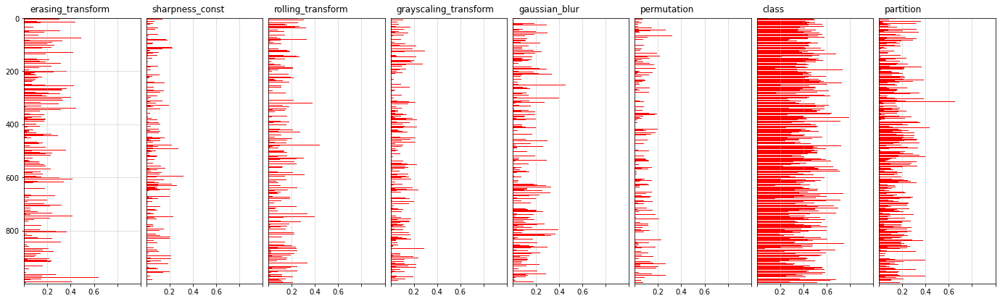

In [58]:
augmentation_set_number = 1

n_col_blocks = 8 # 5 augmentaions + 3 other variables
 
save_dirname = '../results/resnet18/full_sa/'
os.makedirs(save_dirname, exist_ok=True)
save_filename_base = f'resnet18_shpv_augset={augmentation_set_number}'

    
sensitivity_analysis.visualize.shpv_compact_plot(
    shpv_path=shpv_results_path_dict[augmentation_set_number],
    variable_names=variable_names_dict[augmentation_set_number],
    n_col_blocks=n_col_blocks,
    values_func=lambda x: sensitivity_analysis.preprocess_visualize.extract_shp_values_func(
        x, group_indices_dict[augmentation_set_number]
    ),
    show_colorbar=True,
    show=True,
    save_filename_base=save_filename_base,
    save_dirname=save_dirname, 
    **local_params_dict_5_shpv,
)

#### 5.4.2 Augmentation set #2

[[Back to subsection]](#5.4-Shapley-values)

maxpool


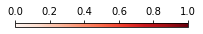

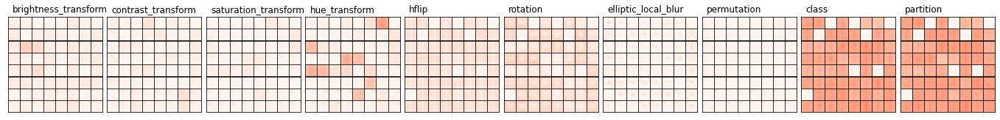

layer1


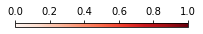

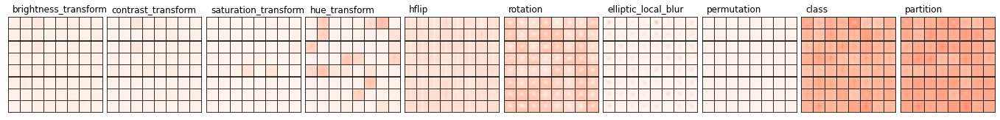

layer2


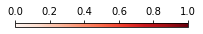

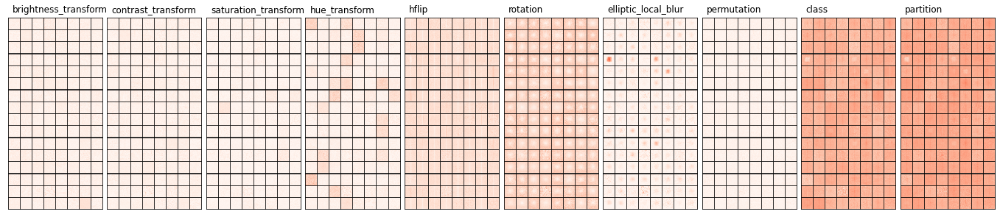

layer3


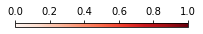

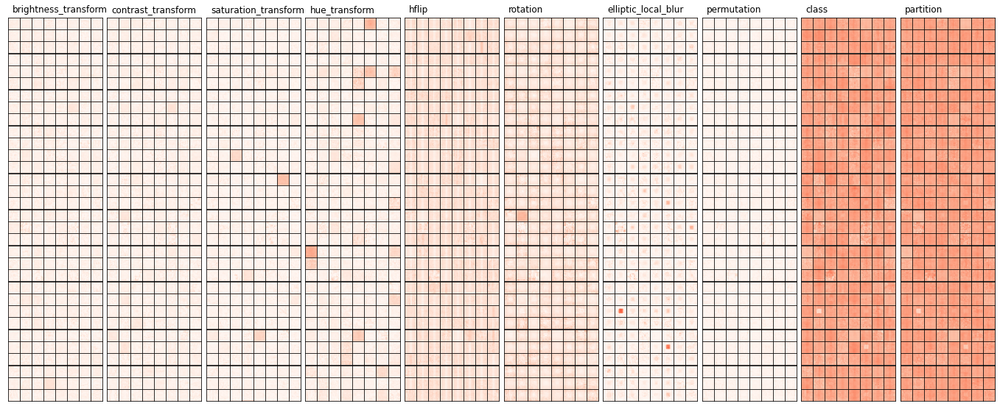

avgpool


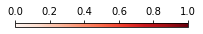

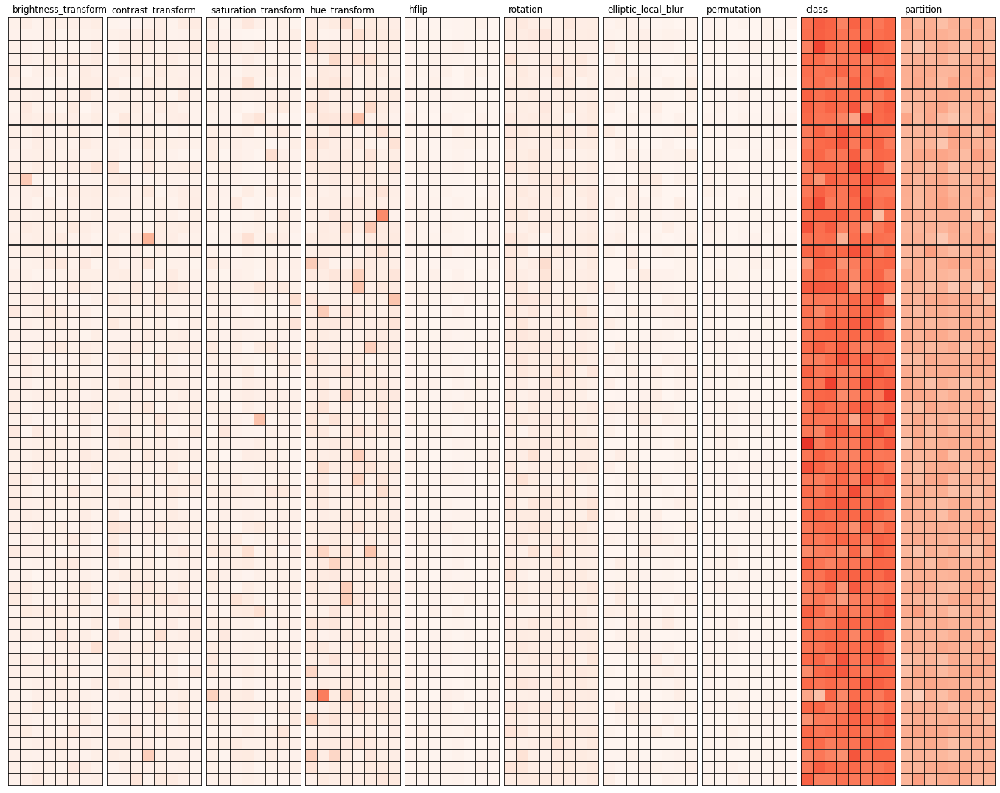

fc


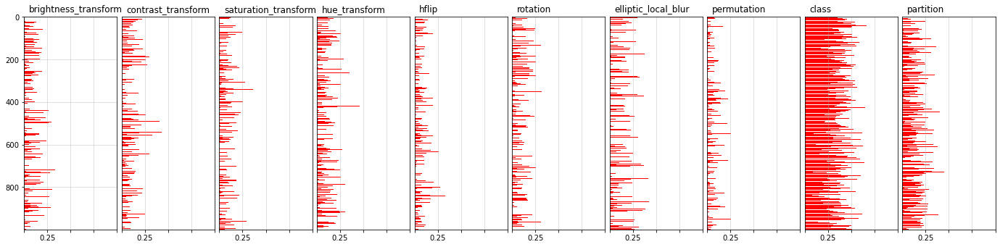

In [59]:
augmentation_set_number = 2
    
n_col_blocks = 10 # 7 augmentaions + 3 other variables
 
save_dirname = '../results/resnet18/full_sa/'
os.makedirs(save_dirname, exist_ok=True)
save_filename_base = f'resnet18_shpv_augset={augmentation_set_number}'

    
sensitivity_analysis.visualize.shpv_compact_plot(
    shpv_path=shpv_results_path_dict[augmentation_set_number],
    variable_names=variable_names_dict[augmentation_set_number],
    n_col_blocks=n_col_blocks,
    values_func=lambda x: sensitivity_analysis.preprocess_visualize.extract_shp_values_func(
        x, group_indices_dict[augmentation_set_number]
    ),
    show_colorbar=True,
    show=True,
    save_filename_base=save_filename_base,
    save_dirname=save_dirname, 
    **local_params_dict_5_shpv,
)

### 5.5 Log-transformed (modules of) mean values

[[$\leftarrow$Prev.subsect.]](#5.4-Shapley-values)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.6-Log-transformed-(total)-variances)

- [5.5.1 Augmentation set #1](#5.5.1-Augmentation-set-#1)
- [5.5.2 Augmentation set #2](#5.5.2-Augmentation-set-#2)

#### 5.5.1 Augmentation set #1

[[Back to subsection]](#5.5-Log-transformed-(modules-of)-mean-values)

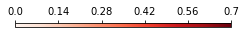

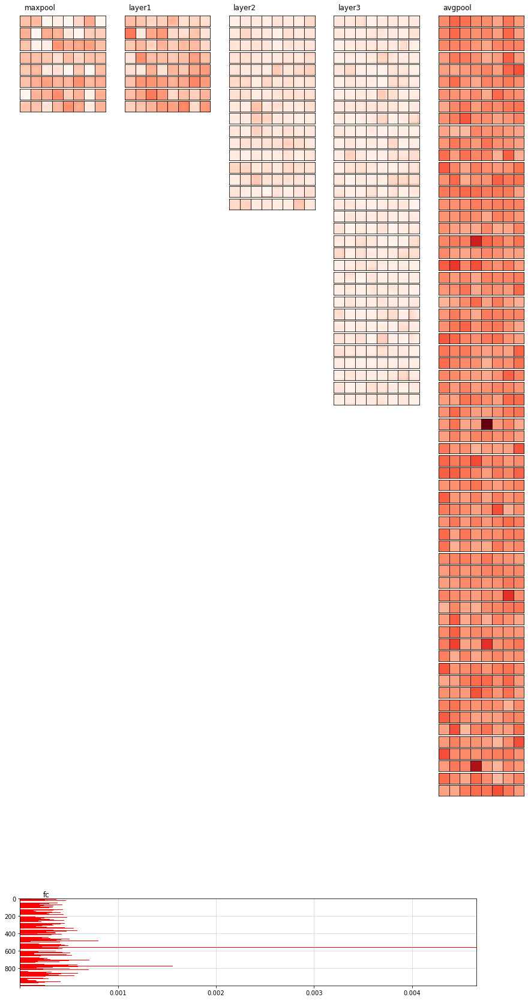

In [51]:
augmentation_set_number = 1

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name='means',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_5_shpv_sum,
)

#### 5.5.2 Augmentation set #2

[[Back to subsection]](#5.5-Log-transformed-(modules-of)-mean-values)

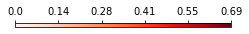

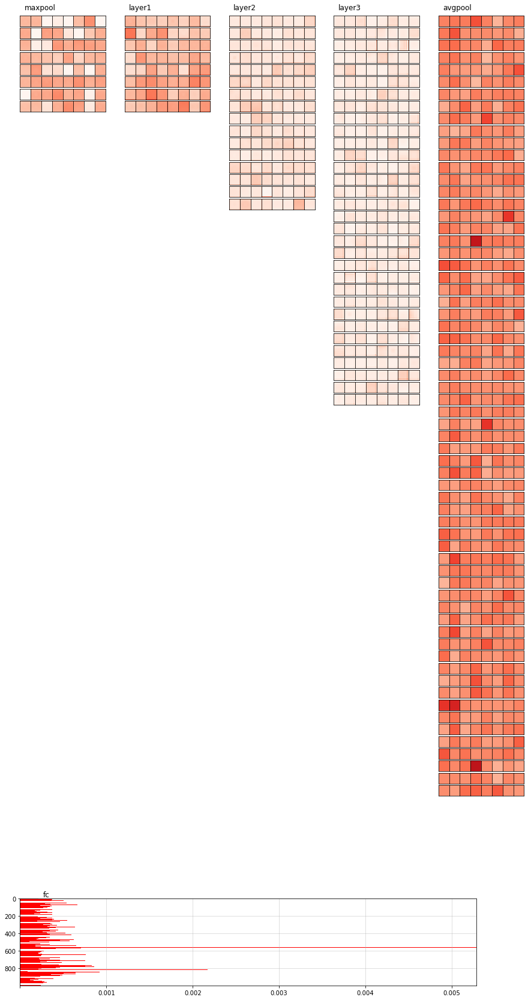

In [52]:
augmentation_set_number = 2

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name='means',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale,
    **local_params_dict_5_shpv_sum,
)

### 5.6 Log-transformed (total) variances

[[$\leftarrow$Prev.subsect.]](#5.5-Log-transformed-(modules-of)-mean-values)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)$\quad$[[Next subsect.$\to$]](#5.7-Coefficients-of-Variance)

- [5.6.1 Augmentation set #1](#5.6.1-Augmentation-set-#1)
- [5.6.2 Augmentation set #2](#5.6.2-Augmentation-set-#2)

#### 5.6.1 Augmentation set #1

[[Back to subsection]](#5.6-Log-transformed-(total)-variances)

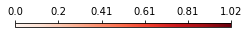

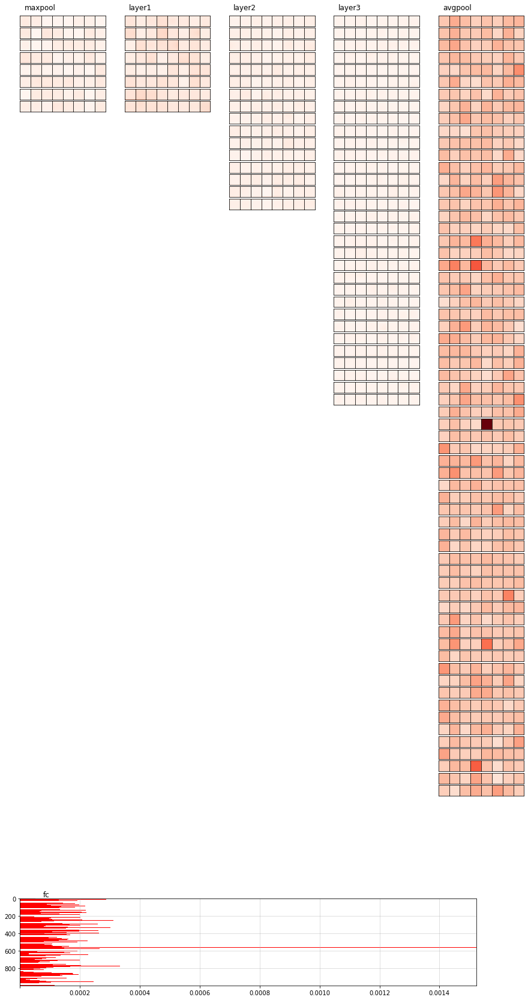

In [53]:
augmentation_set_number = 1

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name='shpv',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale_sum,
    **local_params_dict_5_shpv_sum,
)

#### 5.6.2 Augmentation set #2

[[Back to subsection]](#5.6-Log-transformed-(total)-variances)

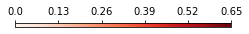

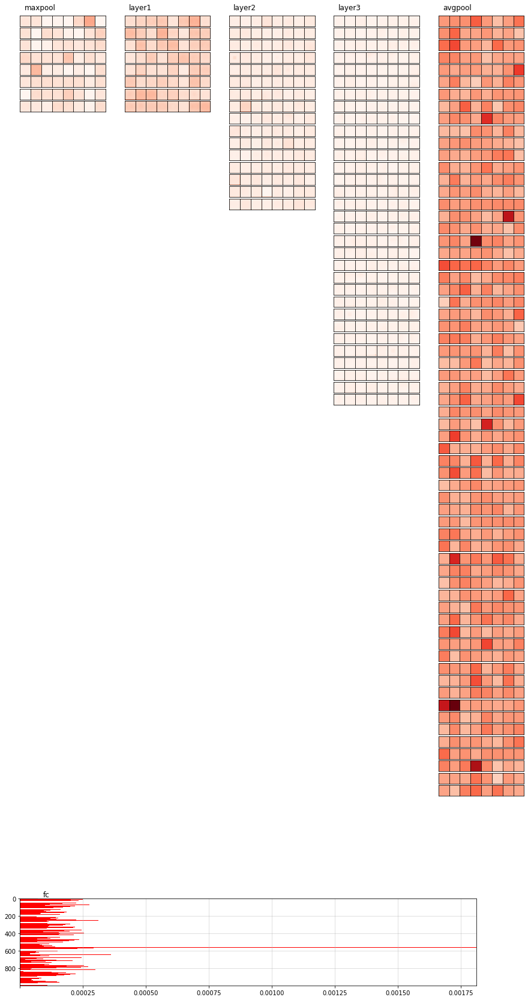

In [54]:
augmentation_set_number = 2

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name='shpv',
    values_func=sensitivity_analysis.preprocess_visualize.log_scale_sum,
    **local_params_dict_5_shpv_sum,
)

### 5.7 Coefficients of Variance

[[$\leftarrow$Prev.subsect.]](#5.6-Log-transformed-(total)-variances)$\quad$[[Back to section]](#5.-Sampling-scheme-2:-Shapley-values)

- [5.7.1 Augmentation set #1](#5.7.1-Augmentation-set-#1)
- [5.7.2 Augmentation set #2](#5.7.2-Augmentation-set-#2)

#### 5.7.1 Augmentation set #1

[[Back to subsection]](#5.7-Coefficients-of-Variance)

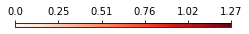

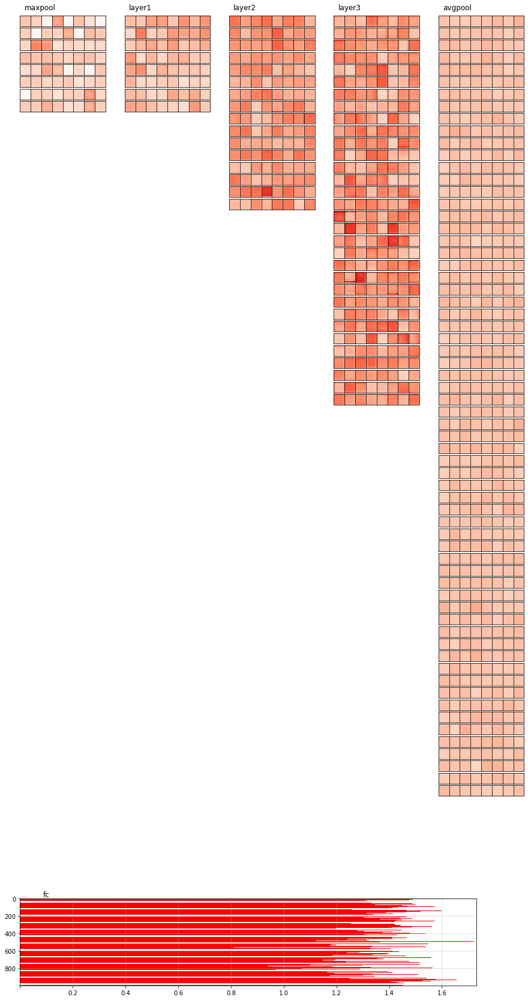

In [55]:
augmentation_set_number = 1

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name=('shpv', 'means'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_shpv_coef_var,
    **local_params_dict_5_shpv_sum,
)

#### 5.7.2 Augmentation set #2

[[Back to subsection]](#5.7-Coefficients-of-Variance)

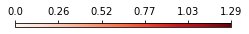

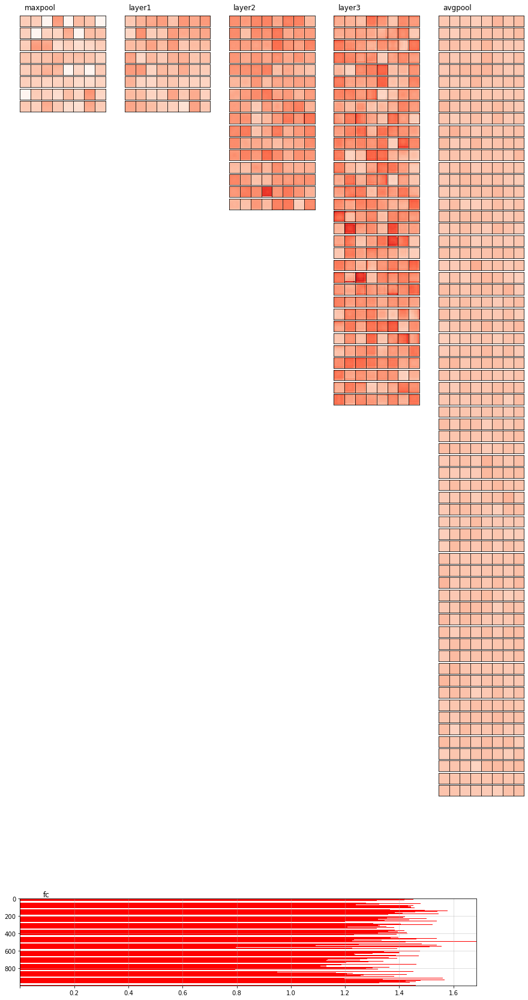

In [56]:
augmentation_set_number = 2

fig = sensitivity_analysis.visualize.custom_plot_single_value_images(
    values_path=shpv_results_path_dict[augmentation_set_number],
    values_name=('shpv', 'means'),
    values_func=sensitivity_analysis.preprocess_visualize.compute_shpv_coef_var,
    **local_params_dict_5_shpv_sum,
)

[[Back to top]](#Navigation)